<a href="https://colab.research.google.com/github/Deshy23/Dog2Pokedog/blob/main/Dog2Pokedog.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [36]:
%%capture
!pip install torchnet

In [37]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [16]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.utils import make_grid
import torch.utils.data as data
import matplotlib.pyplot as plt
from torch.cuda.amp import autocast
import numpy as np
torch.manual_seed(0)

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_shifted = image_tensor
    image_unflat = image_shifted.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()


import glob
import random
import os
from torch.utils.data import Dataset
from PIL import Image

import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0)

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_shifted = image_tensor
    image_unflat = image_shifted.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()


import glob
import random
import os
from torch.utils.data import Dataset
from PIL import Image

# Inspired by https://github.com/aitorzip/PyTorch-CycleGAN/blob/master/datasets.py
class ImageDataset(data.Dataset):
    def __init__(self, data_rootA, data_rootB, transform=None):
        self.transform = transform
        self.files_A = []
        self.files_B = []
        for path, subdirs, files in os.walk(data_rootA):
            for name in files:
                if name.endswith(".jpg"):
                    self.files_A.append(os.path.join(path, name))
        for path, subdirs, files in os.walk(data_rootB):
            for name in files:
                if name.endswith(".png"):
                    self.files_B.append(os.path.join(path, name))
        if len(self.files_A) > len(self.files_B):
            self.files_A, self.files_B = self.files_B, self.files_A
        self.new_perm()
        assert len(self.files_A) > 0, "Make sure you downloaded the horse2zebra images!"

    def new_perm(self):
        self.randperm = torch.randperm(len(self.files_B))[:len(self.files_A)]

    def __getitem__(self, index):
        item_A = self.transform(Image.open(self.files_A[index % len(self.files_A)]))
        item_B = self.transform(Image.open(self.files_B[self.randperm[index]]))
        if item_A.shape[0] != 3: 
            item_A = item_A.repeat(3, 1, 1)
        if item_B.shape[0] != 3: 
            item_B = item_B.repeat(3, 1, 1)
        if index == len(self) - 1:
            self.new_perm()
        # Old versions of PyTorch didn't support normalization for different-channeled images
        return (item_A - 0.5) * 2, (item_B - 0.5) * 2

    def __len__(self):
        return min(len(self.files_A), len(self.files_B))

class Dataset(data.Dataset):
    """Dataset class for dsprites"""

    def __init__(self, normalize=False, data_root="/content/drive/My Drive/Gproj"):
        
        # Recursively exract paths to all .png files in subdirectories
        self.file_paths = []
        for path, subdirs, files in os.walk(data_root):
            for name in files:
                if name.endswith(".png"):
                    self.file_paths.append(os.path.join(path, name))
                    #print(name)
                
        self.transform = self._set_transforms(normalize)

    def _set_transforms(self, use_normalize=True):
        """Decide transformations to data to be applied"""
        transforms_list = []

        # Normalize to the mean and standard deviation all pretrained
        # torchvision models expect
        normalize = transforms.Normalize(mean=(0.5,),
                                         std=(0.5,))

        # 1) transforms PIL image in range [0,255] to [0,1],
        # 2) transposes [H, W, C] to [C, H, W]
        transforms_list += [transforms.Lambda(lambda img: transforms.ToTensor()(img)[:3,:, :])]
        transforms_list += [transforms.Resize(size = (255,255))]
        transforms_list += [transforms.RandomHorizontalFlip()]
        if use_normalize:
            transforms_list += [normalize]
        else:
            transforms_list += []
        transform = transforms.Compose([t for t in transforms_list if t])
        return transform

    def __len__(self):
        """Required: specify dataset length for dataloader"""
        return len(self.file_paths)

    def __getitem__(self, index):
        """Required: specify what each iteration in dataloader yields"""
        img = Image.open(self.file_paths[index])
        img = self.transform(img)
        #print(img.shape)
        return img

In [5]:
!nvidia-smi

Wed Feb 16 23:36:32 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   31C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [6]:
import torch.nn.functional as F

adv_criterion = nn.MSELoss() 
recon_criterion = nn.L1Loss() 

n_epochs = 20
dim_A = 3
dim_B = 3
display_step = 5
batch_size = 1
lr = 0.0002
load_shape = 286
target_shape = 256
device = 'cuda'

In [7]:
seed = 0
os.environ['PYTHONHASHSEED'] = str(seed)
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
np.random.seed(seed)
torch.backends.cudnn.deterministic = True

In [49]:
batch_size = 4
num_workers = 2. # how many subprocesses to use for data loading. these work asynchronously on CPU as your model works on GPU
#poke_dataset = Dataset(normalize=True, data_root="/content/drive/My Drive/Gproj/pokedogs")
#dog_dataset = Dataset(normalize=True, data_root="/content/drive/My Drive/Gproj/Dogs")
#print(dataset[0])
# poke_dataloader = data.DataLoader(poke_dataset,
#                              batch_size=batch_size,
#                              shuffle=True)
# dog_dataloader = data.DataLoader(poke_dataset,
#                              batch_size=batch_size,
#                              shuffle=True)
transform = transforms.Compose([
    transforms.Lambda(lambda img: transforms.ToTensor()(img)[:3,:, :]),
    transforms.Resize(size = (255,255)),
    transforms.RandomHorizontalFlip(),
])
dataset = ImageDataset(data_rootA="/content/drive/My Drive/Gproj/Dogs", data_rootB ="/content/drive/My Drive/Gproj/pokedogs", transform=transform)
dataloader = data.DataLoader(dataset,
                             batch_size=batch_size,
                             shuffle=True)

In [50]:
class ResidualBlock(nn.Module):
    '''
    ResidualBlock Class:
    Performs two convolutions and an instance normalization, the input is added
    to this output to form the residual block output.
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding=1, padding_mode='reflect')
        self.conv2 = nn.Conv2d(input_channels, input_channels, kernel_size=3, padding=1, padding_mode='reflect')
        self.instancenorm = nn.InstanceNorm2d(input_channels)
        self.activation = nn.ReLU()

    def forward(self, x):
        '''
        Function for completing a forward pass of ResidualBlock: 
        Given an image tensor, completes a residual block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        original_x = x.clone()
        x = self.conv1(x)
        x = self.instancenorm(x)
        x = self.activation(x)
        x = self.conv2(x)
        x = self.instancenorm(x)
        return original_x + x

class ContractingBlock(nn.Module):
    '''
    ContractingBlock Class
    Performs a convolution followed by a max pool operation and an optional instance norm.
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels, use_bn=True, kernel_size=3, activation='relu'):
        super(ContractingBlock, self).__init__()
        self.conv1 = nn.Conv2d(input_channels, input_channels * 2, kernel_size=kernel_size, padding=1, stride=2, padding_mode='reflect')
        self.activation = nn.ReLU() if activation == 'relu' else nn.LeakyReLU(0.2)
        if use_bn:
            self.instancenorm = nn.InstanceNorm2d(input_channels * 2)
        self.use_bn = use_bn

    def forward(self, x):
        '''
        Function for completing a forward pass of ContractingBlock: 
        Given an image tensor, completes a contracting block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x = self.conv1(x)
        if self.use_bn:
            x = self.instancenorm(x)
        x = self.activation(x)
        return x

class ExpandingBlock(nn.Module):
    '''
    ExpandingBlock Class:
    Performs a convolutional transpose operation in order to upsample, 
        with an optional instance norm
    Values:
        input_channels: the number of channels to expect from a given input
    '''
    def __init__(self, input_channels, use_bn=True):
        super(ExpandingBlock, self).__init__()
        self.conv1 = nn.ConvTranspose2d(input_channels, input_channels // 2, kernel_size=3, stride=2, padding=1, output_padding=1)
        if use_bn:
            self.instancenorm = nn.InstanceNorm2d(input_channels // 2)
        self.use_bn = use_bn
        self.activation = nn.ReLU()

    def forward(self, x):
        '''
        Function for completing a forward pass of ExpandingBlock: 
        Given an image tensor, completes an expanding block and returns the transformed tensor.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
            skip_con_x: the image tensor from the contracting path (from the opposing block of x)
                    for the skip connection
        '''
        x = self.conv1(x)
        if self.use_bn:
            x = self.instancenorm(x)
        x = self.activation(x)
        return x

class FeatureMapBlock(nn.Module):
    '''
    FeatureMapBlock Class
    The final layer of a Generator - 
    maps each the output to the desired number of output channels
    Values:
        input_channels: the number of channels to expect from a given input
        output_channels: the number of channels to expect for a given output
    '''
    def __init__(self, input_channels, output_channels):
        super(FeatureMapBlock, self).__init__()
        self.conv = nn.Conv2d(input_channels, output_channels, kernel_size=7, padding=3, padding_mode='reflect')

    def forward(self, x):
        '''
        Function for completing a forward pass of FeatureMapBlock: 
        Given an image tensor, returns it mapped to the desired number of channels.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x = self.conv(x)
        return x

In [51]:
class Generator(nn.Module):
    '''
    Generator Class
    A series of 2 contracting blocks, 9 residual blocks, and 2 expanding blocks to 
    transform an input image into an image from the other class, with an upfeature
    layer at the start and a downfeature layer at the end.
    Values:
        input_channels: the number of channels to expect from a given input
        output_channels: the number of channels to expect for a given output
    '''
    def __init__(self, input_channels, output_channels, hidden_channels=64):
        super(Generator, self).__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels)
        self.contract2 = ContractingBlock(hidden_channels * 2)
        res_mult = 4
        self.res0 = ResidualBlock(hidden_channels * res_mult)
        self.res1 = ResidualBlock(hidden_channels * res_mult)
        self.res2 = ResidualBlock(hidden_channels * res_mult)
        self.res3 = ResidualBlock(hidden_channels * res_mult)
        self.res4 = ResidualBlock(hidden_channels * res_mult)
        self.res5 = ResidualBlock(hidden_channels * res_mult)
        self.res6 = ResidualBlock(hidden_channels * res_mult)
        self.res7 = ResidualBlock(hidden_channels * res_mult)
        self.res8 = ResidualBlock(hidden_channels * res_mult)
        self.expand2 = ExpandingBlock(hidden_channels * 4)
        self.expand3 = ExpandingBlock(hidden_channels * 2)
        self.downfeature = FeatureMapBlock(hidden_channels, output_channels)
        self.tanh = torch.nn.Tanh()

    def forward(self, x):
        '''
        Function for completing a forward pass of Generator: 
        Given an image tensor, passes it through the U-Net with residual blocks
        and returns the output.
        Parameters:
            x: image tensor of shape (batch size, channels, height, width)
        '''
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.res0(x2)
        x4 = self.res1(x3)
        x5 = self.res2(x4)
        x6 = self.res3(x5)
        x7 = self.res4(x6)
        x8 = self.res5(x7)
        x9 = self.res6(x8)
        x10 = self.res7(x9)
        x11 = self.res8(x10)
        x12 = self.expand2(x11)
        x13 = self.expand3(x12)
        xn = self.downfeature(x13)
        return self.tanh(xn)

In [52]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Structured like the contracting path of the U-Net, the discriminator will
    output a matrix of values classifying corresponding portions of the image as real or fake. 
    Parameters:
        input_channels: the number of image input channels
        hidden_channels: the initial number of discriminator convolutional filters
    '''
    def __init__(self, input_channels, hidden_channels=64):
        super(Discriminator, self).__init__()
        self.upfeature = FeatureMapBlock(input_channels, hidden_channels)
        self.contract1 = ContractingBlock(hidden_channels, use_bn=False, kernel_size=4, activation='lrelu')
        self.contract2 = ContractingBlock(hidden_channels * 2, kernel_size=4, activation='lrelu')
        self.contract3 = ContractingBlock(hidden_channels * 4, kernel_size=4, activation='lrelu')
        self.final = nn.Conv2d(hidden_channels * 8, 1, kernel_size=1)

    def forward(self, x):
        x0 = self.upfeature(x)
        x1 = self.contract1(x0)
        x2 = self.contract2(x1)
        x3 = self.contract3(x2)
        xn = self.final(x3)
        return xn

In [61]:
import torch.nn.functional as F

adv_criterion = nn.MSELoss() 
recon_criterion = nn.L1Loss() 

n_epochs = 20
dim_A = 3
dim_B = 3
display_step = 5
batch_size = 1
lr = 0.0002
load_shape = 286
target_shape = 256
device = 'cuda'

In [54]:
import torchvision
#print(dataset[0])

In [55]:
gen_AB = Generator(dim_A, dim_B).to(device)
gen_BA = Generator(dim_B, dim_A).to(device)
gen_opt = torch.optim.Adam(list(gen_AB.parameters()) + list(gen_BA.parameters()), lr=lr, betas=(0.5, 0.999))
disc_A = Discriminator(dim_A).to(device)
disc_A_opt = torch.optim.Adam(disc_A.parameters(), lr=lr, betas=(0.5, 0.999))
disc_B = Discriminator(dim_B).to(device)
disc_B_opt = torch.optim.Adam(disc_B.parameters(), lr=lr, betas=(0.5, 0.999))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

# Feel free to change pretrained to False if you're training the model from scratch
pretrained = False
if pretrained:
    pre_dict = torch.load('cycleGAN_100000.pth')
    gen_AB.load_state_dict(pre_dict['gen_AB'])
    gen_BA.load_state_dict(pre_dict['gen_BA'])
    gen_opt.load_state_dict(pre_dict['gen_opt'])
    disc_A.load_state_dict(pre_dict['disc_A'])
    disc_A_opt.load_state_dict(pre_dict['disc_A_opt'])
    disc_B.load_state_dict(pre_dict['disc_B'])
    disc_B_opt.load_state_dict(pre_dict['disc_B_opt'])
else:
    gen_AB = gen_AB.apply(weights_init)
    gen_BA = gen_BA.apply(weights_init)
    disc_A = disc_A.apply(weights_init)
    disc_B = disc_B.apply(weights_init)

In [56]:
def get_disc_loss(real_X, fake_X, disc_X, adv_criterion):
    '''
    Return the loss of the discriminator given inputs.
    Parameters:
        real_X: the real images from pile X
        fake_X: the generated images of class X
        disc_X: the discriminator for class X; takes images and returns real/fake class X
            prediction matrices
        adv_criterion: the adversarial loss function; takes the discriminator 
            predictions and the target labels and returns a adversarial 
            loss (which you aim to minimize)
    '''
    #### START CODE HERE ####
    pred = disc_X(real_X)
    real_loss = adv_criterion(pred, torch.ones_like(pred))
    pred =  disc_X(fake_X)
    fake_loss = adv_criterion(pred, torch.zeros_like(pred))
    disc_loss = (real_loss + fake_loss)/2
    #disc_loss = torch.sum((real_loss + fake_loss)/2)
    #### END CODE HERE ####
    return disc_loss

In [57]:
def get_gen_adversarial_loss(real_X, disc_Y, gen_XY, adv_criterion):
    '''
    Return the adversarial loss of the generator given inputs
    (and the generated images for testing purposes).
    Parameters:
        real_X: the real images from pile X
        disc_Y: the discriminator for class Y; takes images and returns real/fake class Y
            prediction matrices
        gen_XY: the generator for class X to Y; takes images and returns the images 
            transformed to class Y
        adv_criterion: the adversarial loss function; takes the discriminator 
                  predictions and the target labels and returns a adversarial 
                  loss (which you aim to minimize)
    '''
    #### START CODE HERE ####
    fake_Y = gen_XY(real_X)
    pred = disc_Y(fake_Y)
    adversarial_loss = adv_criterion(pred, torch.ones_like(pred))
    #adversarial_loss = torch.sum(adv_criterion(pred, torch.ones_like(pred)))
    #### END CODE HERE ####
    return adversarial_loss, fake_Y

In [58]:
def get_identity_loss(real_X, gen_YX, identity_criterion):
    '''
    Return the identity loss of the generator given inputs
    (and the generated images for testing purposes).
    Parameters:
        real_X: the real images from pile X
        gen_YX: the generator for class Y to X; takes images and returns the images 
            transformed to class X
        identity_criterion: the identity loss function; takes the real images from X and
                        those images put through a Y->X generator and returns the identity 
                        loss (which you aim to minimize)
    '''
    #### START CODE HERE ####
    identity_X = gen_YX(real_X)
    identity_loss = identity_criterion(real_X, identity_X)
    #identity_loss = torch.sum(identity_criterion(real_X, identity_X))
    #### END CODE HERE ####
    return identity_loss, identity_X
  
def get_cycle_consistency_loss(real_X, fake_Y, gen_YX, cycle_criterion):
    '''
    Return the cycle consistency loss of the generator given inputs
    (and the generated images for testing purposes).
    Parameters:
        real_X: the real images from pile X
        fake_Y: the generated images of class Y
        gen_YX: the generator for class Y to X; takes images and returns the images 
            transformed to class X
        cycle_criterion: the cycle consistency loss function; takes the real images from X and
                        those images put through a X->Y generator and then Y->X generator
                        and returns the cycle consistency loss (which you aim to minimize)
    '''
    #### START CODE HERE ####
    cycle_X = gen_YX(fake_Y)
    cycle_loss = cycle_criterion(real_X,cycle_X)
    #### END CODE HERE ####
    return cycle_loss, cycle_X

In [59]:
def get_gen_loss(real_A, real_B, gen_AB, gen_BA, disc_A, disc_B, adv_criterion, identity_criterion, cycle_criterion, lambda_identity=0.1, lambda_cycle=10):
    '''
    Return the loss of the generator given inputs.
    Parameters:
        real_A: the real images from pile A
        real_B: the real images from pile B
        gen_AB: the generator for class A to B; takes images and returns the images 
            transformed to class B
        gen_BA: the generator for class B to A; takes images and returns the images 
            transformed to class A
        disc_A: the discriminator for class A; takes images and returns real/fake class A
            prediction matrices
        disc_B: the discriminator for class B; takes images and returns real/fake class B
            prediction matrices
        adv_criterion: the adversarial loss function; takes the discriminator 
            predictions and the true labels and returns a adversarial 
            loss (which you aim to minimize)
        identity_criterion: the reconstruction loss function used for identity loss
            and cycle consistency loss; takes two sets of images and returns
            their pixel differences (which you aim to minimize)
        cycle_criterion: the cycle consistency loss function; takes the real images from X and
            those images put through a X->Y generator and then Y->X generator
            and returns the cycle consistency loss (which you aim to minimize).
            Note that in practice, cycle_criterion == identity_criterion == L1 loss
        lambda_identity: the weight of the identity loss
        lambda_cycle: the weight of the cycle-consistency loss
    '''
    # Hint 1: Make sure you include both directions - you can think of the generators as collaborating
    # Hint 2: Don't forget to use the lambdas for the identity loss and cycle loss!
    #### START CODE HERE ####
    # Adversarial Loss -- get_gen_adversarial_loss(real_X, disc_Y, gen_XY, adv_criterion)
    adv_lossA, fake_B = get_gen_adversarial_loss(real_A, disc_B, gen_AB, adv_criterion)
    adv_lossB, fake_A = get_gen_adversarial_loss(real_B, disc_A, gen_BA, adv_criterion)
    adv_loss = adv_lossA + adv_lossB
    # Identity Loss -- get_identity_loss(real_X, gen_YX, identity_criterion)
    id_loss = get_identity_loss(real_A, gen_BA, identity_criterion)[0] + get_identity_loss(real_B, gen_AB, identity_criterion)[0]
    #id_loss = id_loss[0]
    # Cycle-consistency Loss -- get_cycle_consistency_loss(real_X, fake_Y, gen_YX, cycle_criterion)
    cyc_loss = get_cycle_consistency_loss(real_A, fake_B, gen_BA, cycle_criterion)[0] + get_cycle_consistency_loss(real_B, fake_A, gen_AB, cycle_criterion)[0]
    #cyc_loss = cyc_loss[0]
    # Total loss
    gen_loss = adv_loss + (lambda_identity*id_loss) + (lambda_cycle*cyc_loss)
    #### END CODE HERE ####
    return gen_loss, fake_A, fake_B

  0%|          | 0/235 [00:00<?, ?it/s]

Epoch 0: Step 0: Generator (U-Net) loss: 1.7125373840332032, Discriminator loss: 0.05441943407058716


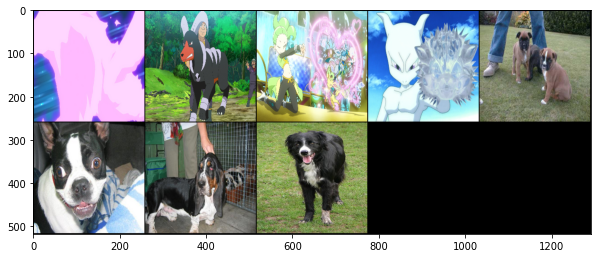

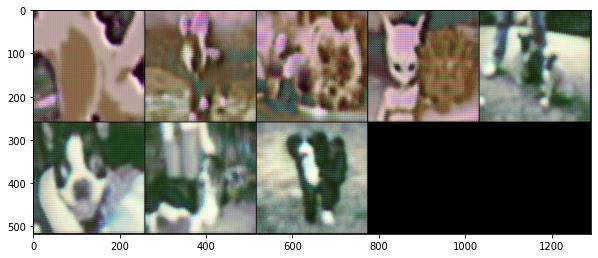

Epoch 0: Step 5: Generator (U-Net) loss: 7.626446628570556, Discriminator loss: 0.2713475167751312


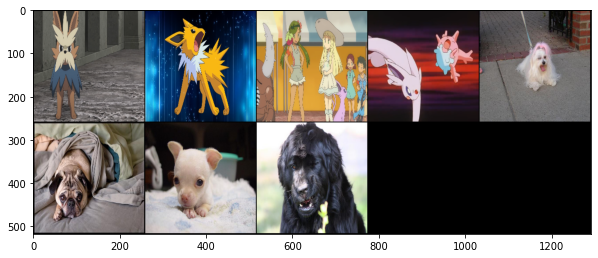

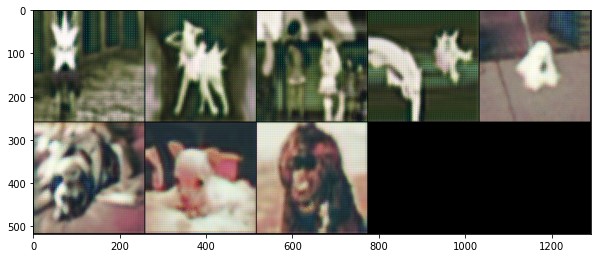

Epoch 0: Step 10: Generator (U-Net) loss: 7.368996524810791, Discriminator loss: 0.24693278074264527


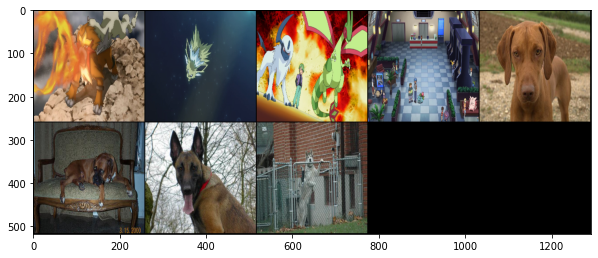

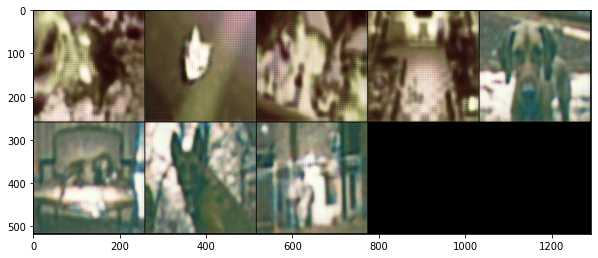

Epoch 0: Step 15: Generator (U-Net) loss: 8.220118999481201, Discriminator loss: 0.23300828933715823


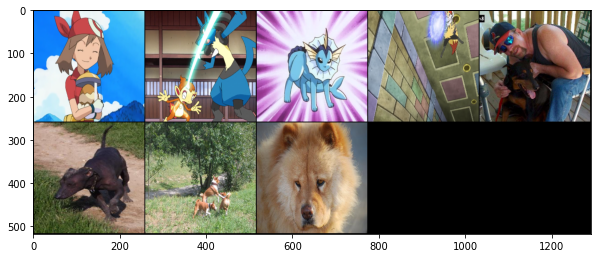

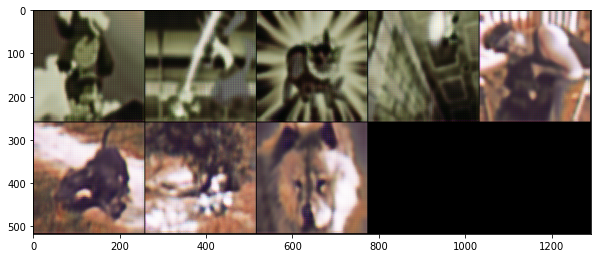

Epoch 0: Step 20: Generator (U-Net) loss: 7.814228820800782, Discriminator loss: 0.23695473670959474


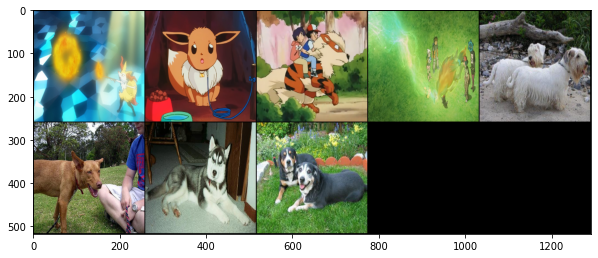

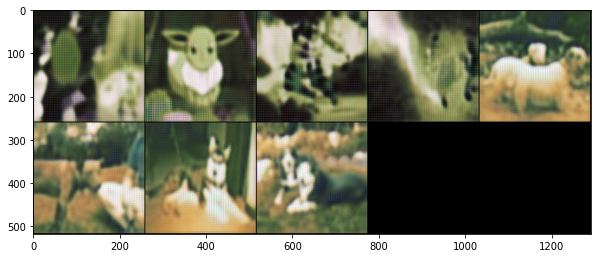

Epoch 0: Step 25: Generator (U-Net) loss: 7.292034912109374, Discriminator loss: 0.2445912629365921


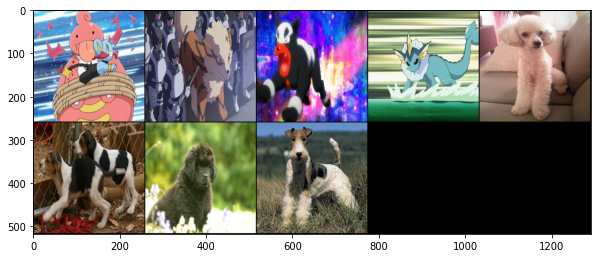

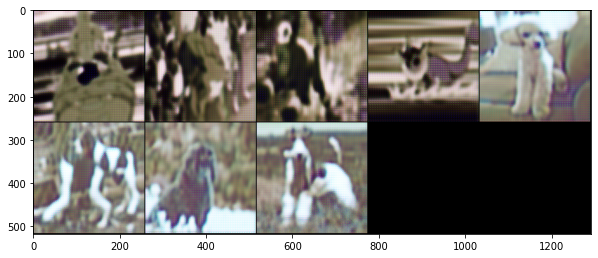

Epoch 0: Step 30: Generator (U-Net) loss: 7.130267238616944, Discriminator loss: 0.2515848368406296


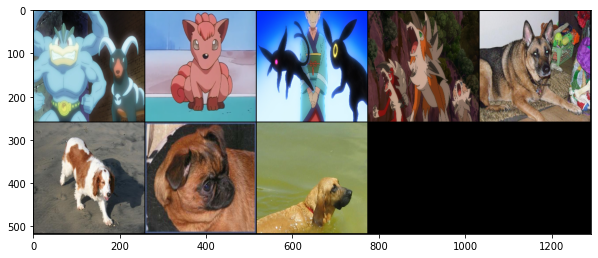

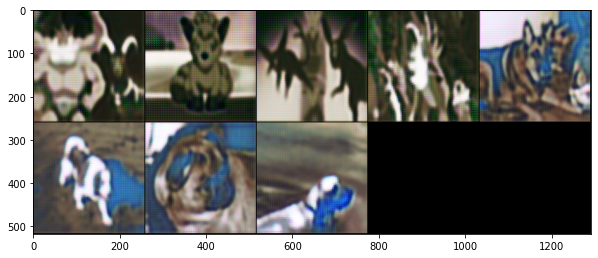

Epoch 0: Step 35: Generator (U-Net) loss: 7.1763878822326665, Discriminator loss: 0.22700469791889188


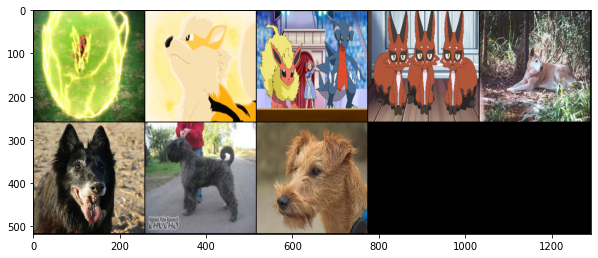

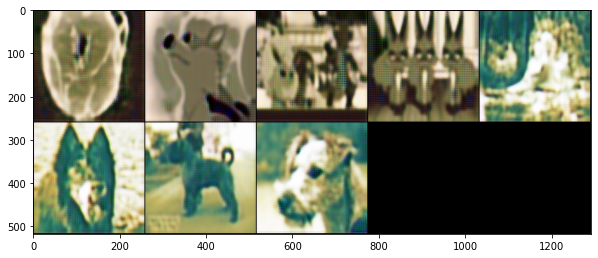

Epoch 0: Step 40: Generator (U-Net) loss: 7.211664009094239, Discriminator loss: 0.2372649610042572


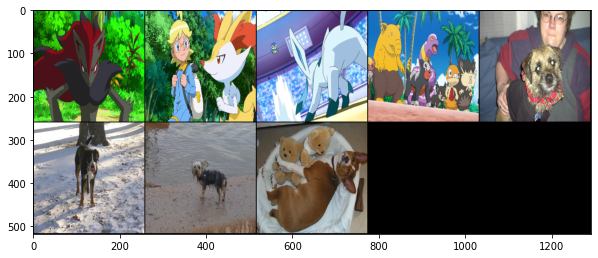

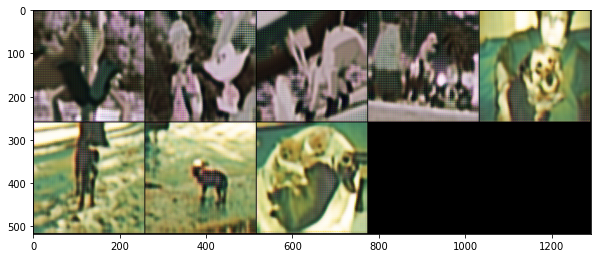

Epoch 0: Step 45: Generator (U-Net) loss: 7.344663715362549, Discriminator loss: 0.2222314476966858


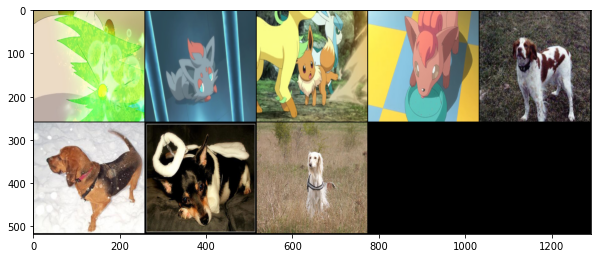

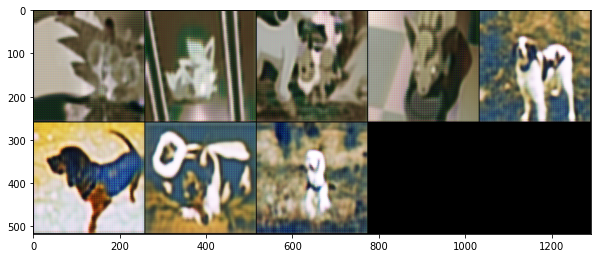

Epoch 0: Step 50: Generator (U-Net) loss: 6.841678142547607, Discriminator loss: 0.23387502431869509


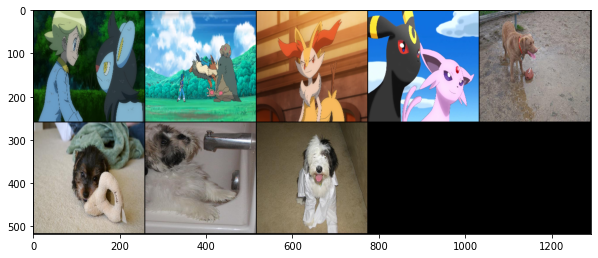

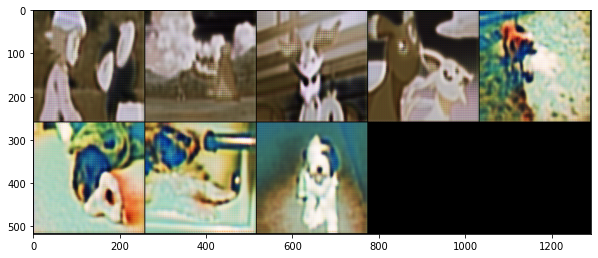

Epoch 0: Step 55: Generator (U-Net) loss: 7.011252117156983, Discriminator loss: 0.2343822985887527


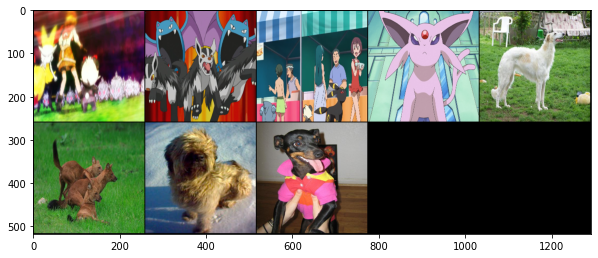

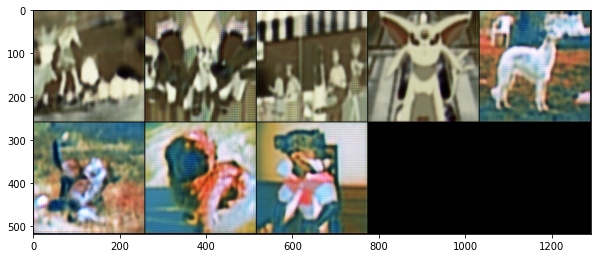

Epoch 0: Step 60: Generator (U-Net) loss: 7.138209247589112, Discriminator loss: 0.23107516765594482


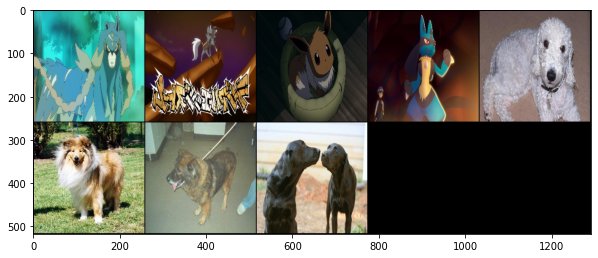

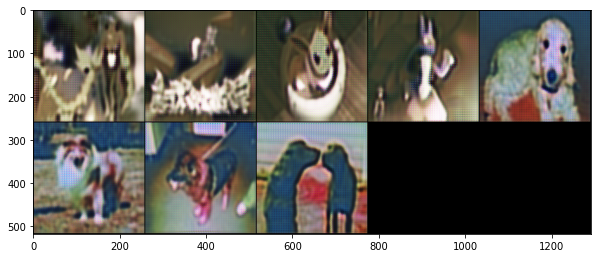

Epoch 0: Step 65: Generator (U-Net) loss: 8.009097290039064, Discriminator loss: 0.24321191012859344


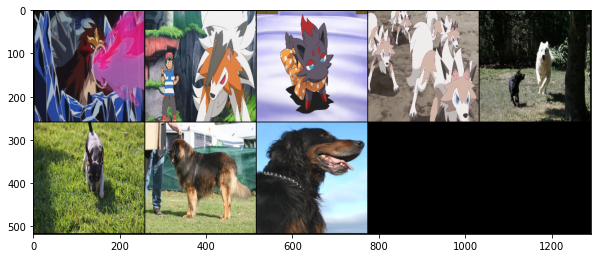

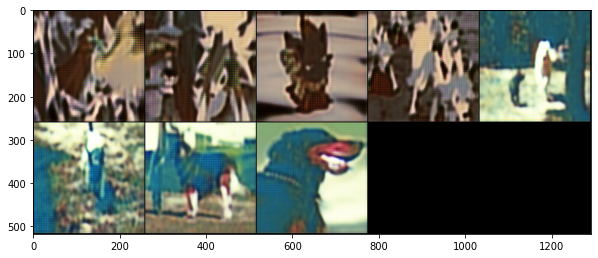

Epoch 0: Step 70: Generator (U-Net) loss: 6.546781921386718, Discriminator loss: 0.22109565138816836


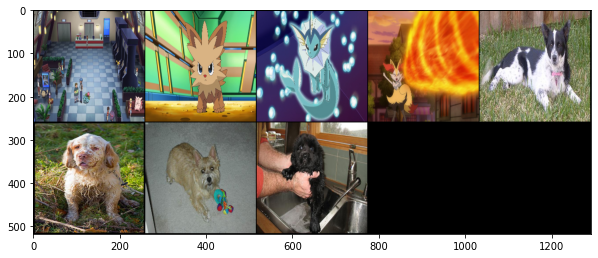

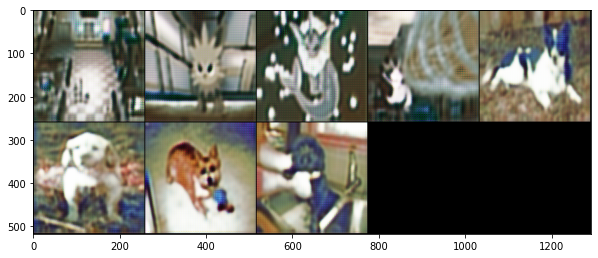

Epoch 0: Step 75: Generator (U-Net) loss: 7.127099800109862, Discriminator loss: 0.21653258502483366


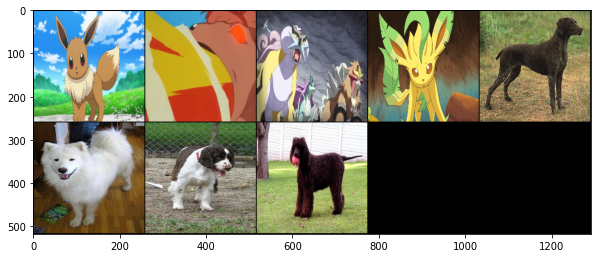

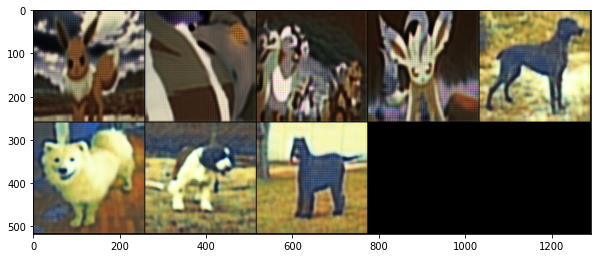

Epoch 0: Step 80: Generator (U-Net) loss: 7.121246814727783, Discriminator loss: 0.21780451536178586


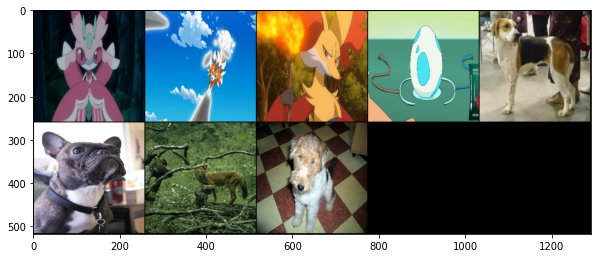

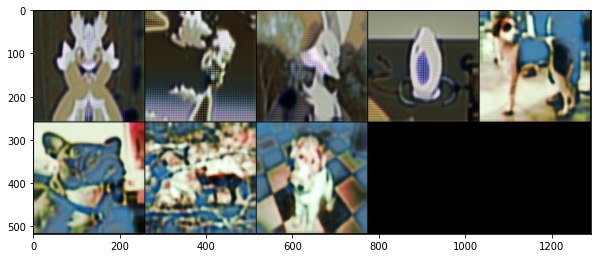

Epoch 0: Step 85: Generator (U-Net) loss: 6.823278427124023, Discriminator loss: 0.21642774641513823


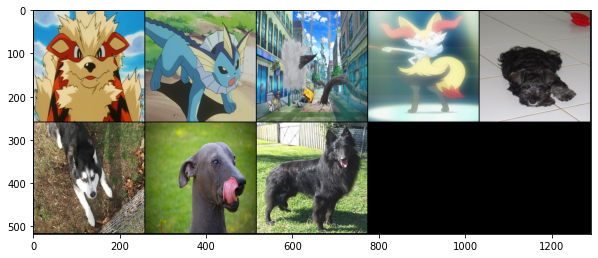

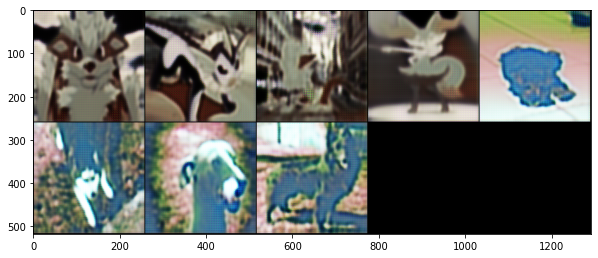

Epoch 0: Step 90: Generator (U-Net) loss: 6.596718692779541, Discriminator loss: 0.23979054093360902


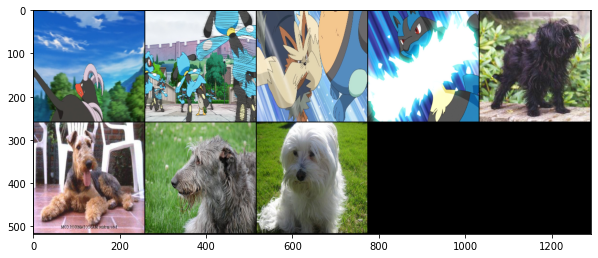

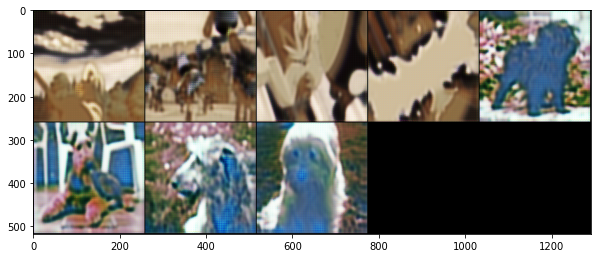

Epoch 0: Step 95: Generator (U-Net) loss: 6.938871955871583, Discriminator loss: 0.22600733935832978


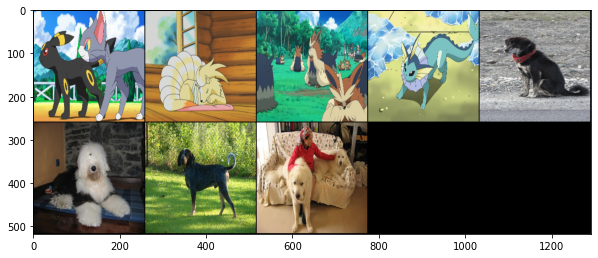

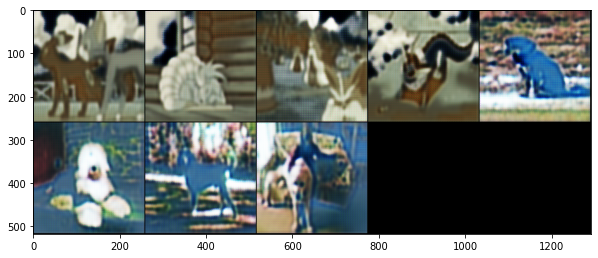

Epoch 0: Step 100: Generator (U-Net) loss: 7.133398914337158, Discriminator loss: 0.24606345295906068


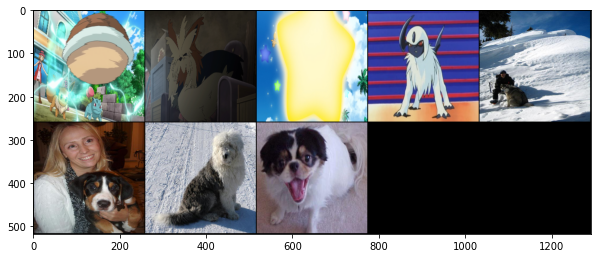

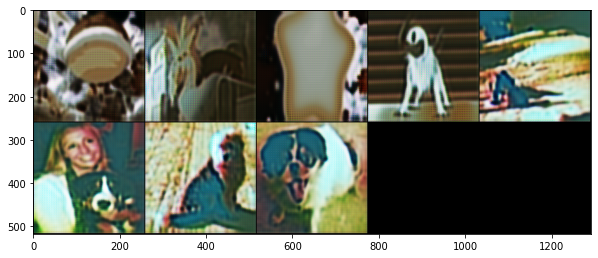

Epoch 0: Step 105: Generator (U-Net) loss: 6.6366020202636715, Discriminator loss: 0.251469212770462


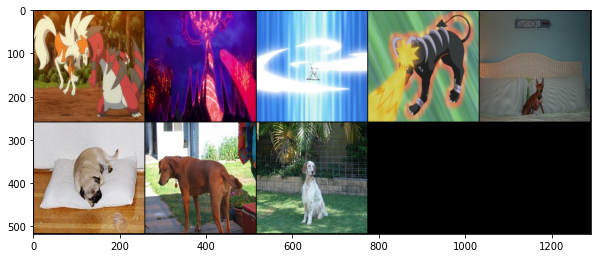

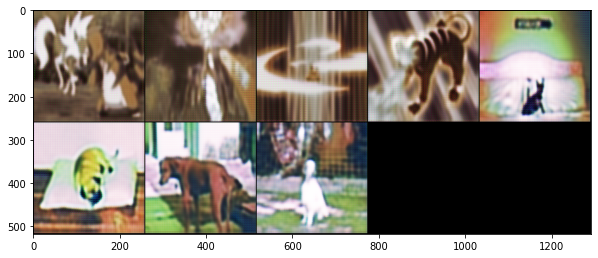

Epoch 0: Step 110: Generator (U-Net) loss: 7.031583499908447, Discriminator loss: 0.24632222354412076


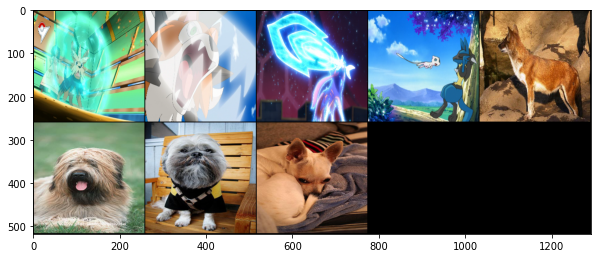

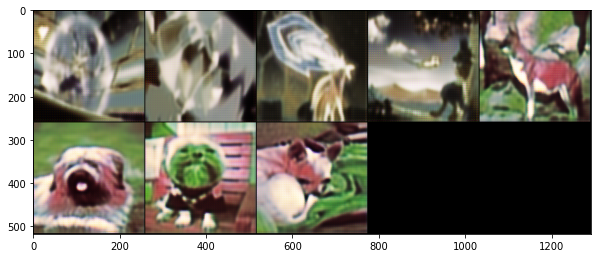

Epoch 0: Step 115: Generator (U-Net) loss: 6.5836873054504395, Discriminator loss: 0.23954858183860778


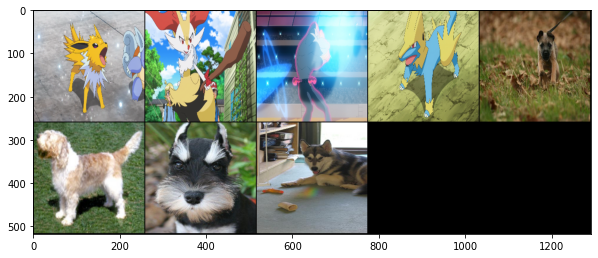

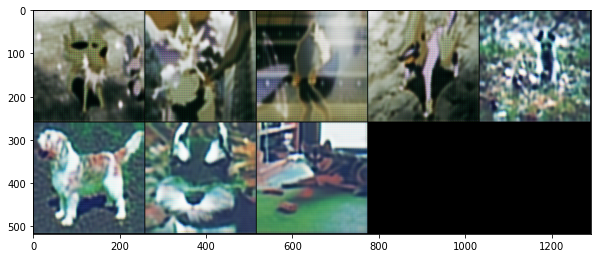

Epoch 0: Step 120: Generator (U-Net) loss: 6.323581981658935, Discriminator loss: 0.22656072080135342


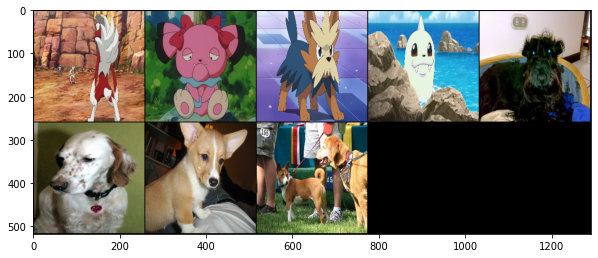

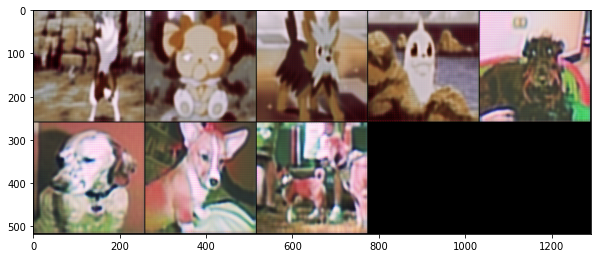

Epoch 0: Step 125: Generator (U-Net) loss: 6.376989364624023, Discriminator loss: 0.21396244466304778


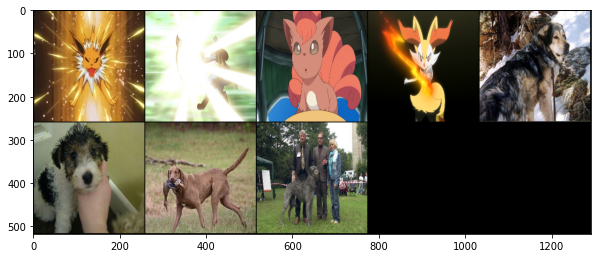

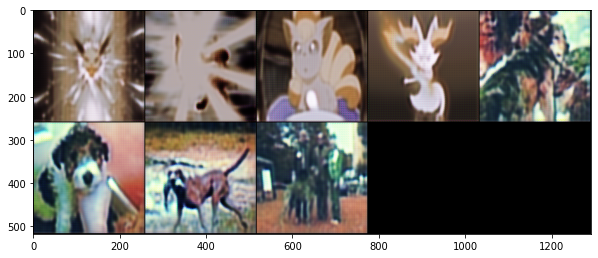

Epoch 0: Step 130: Generator (U-Net) loss: 7.059611415863037, Discriminator loss: 0.22716138064861296


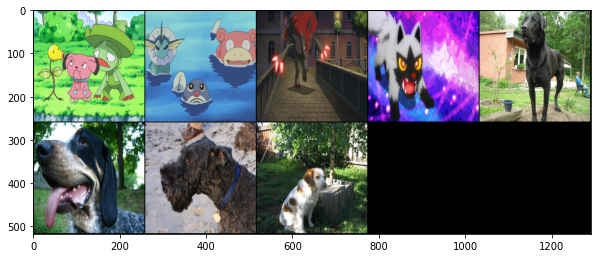

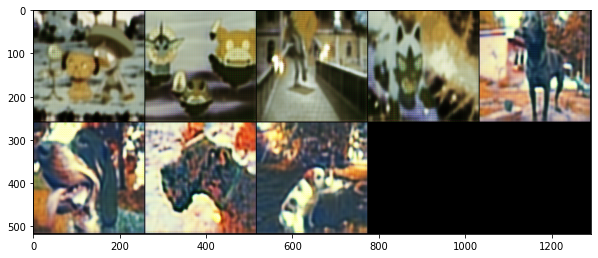

Epoch 0: Step 135: Generator (U-Net) loss: 6.528304195404053, Discriminator loss: 0.22233562171459198


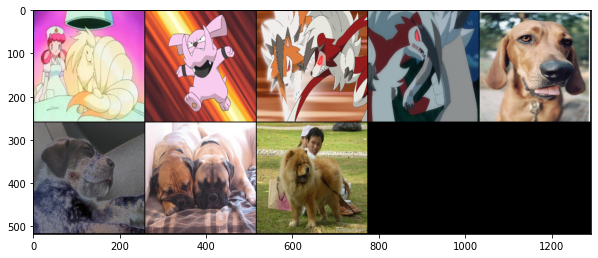

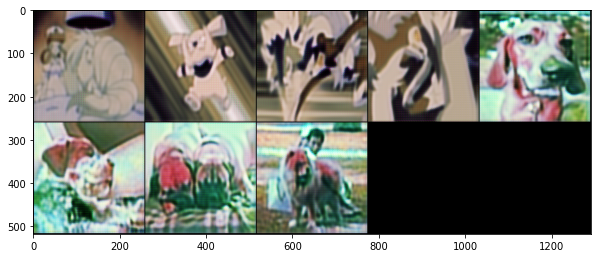

Epoch 0: Step 140: Generator (U-Net) loss: 6.286976623535155, Discriminator loss: 0.23442001342773436


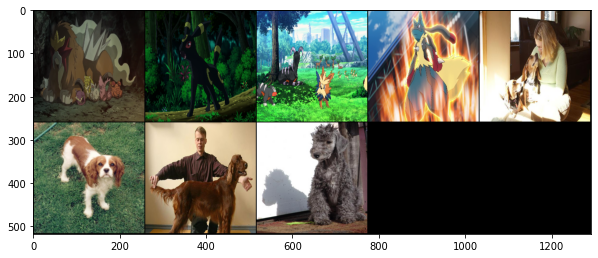

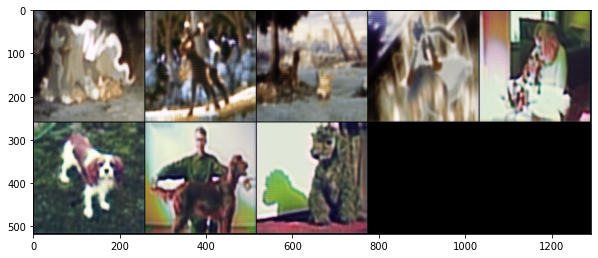

Epoch 0: Step 145: Generator (U-Net) loss: 7.159198379516601, Discriminator loss: 0.2652905911207199


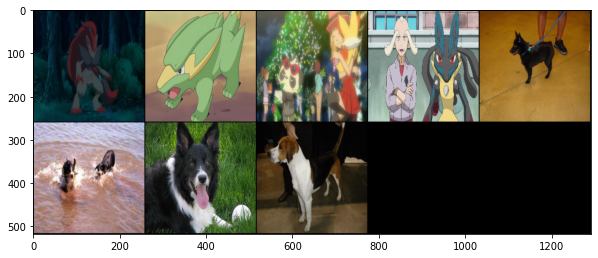

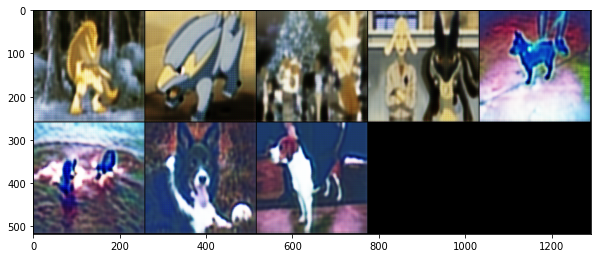

Epoch 0: Step 150: Generator (U-Net) loss: 6.47485704421997, Discriminator loss: 0.2451060026884079


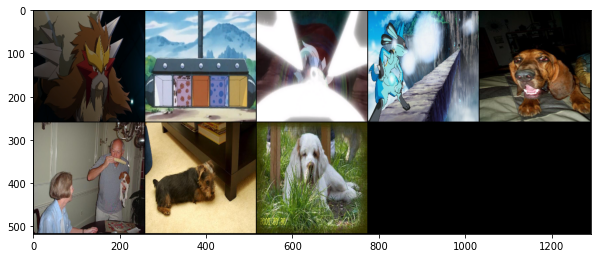

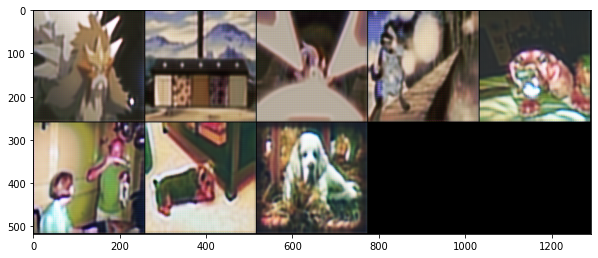

Epoch 0: Step 155: Generator (U-Net) loss: 6.149655723571777, Discriminator loss: 0.23045926988124849


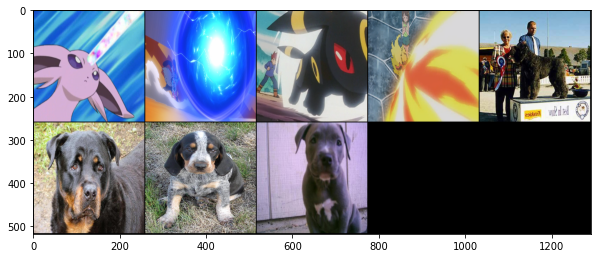

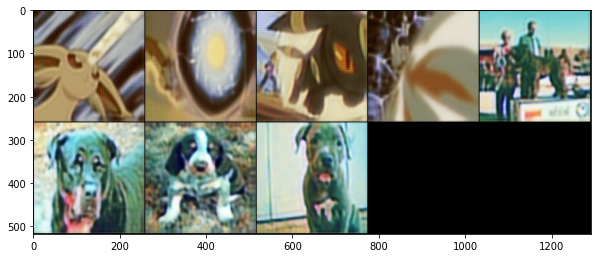

Epoch 0: Step 160: Generator (U-Net) loss: 6.081777572631836, Discriminator loss: 0.24288504421710969


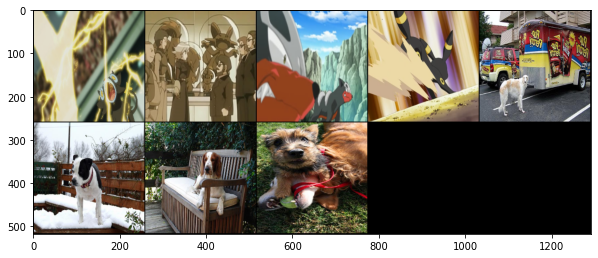

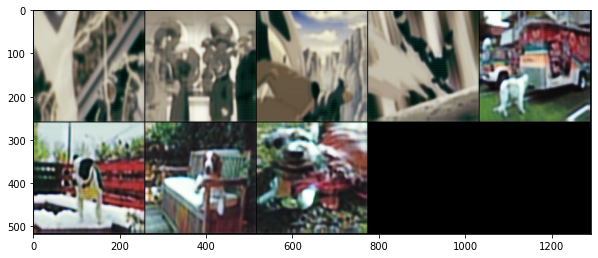

Epoch 0: Step 165: Generator (U-Net) loss: 6.7455153465271, Discriminator loss: 0.23221990764141082


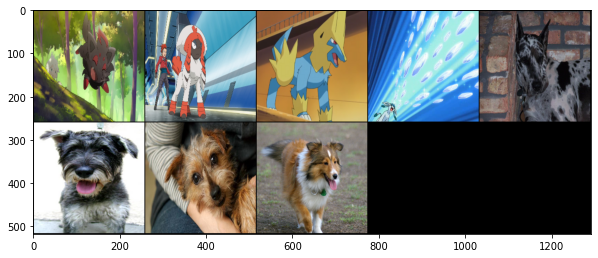

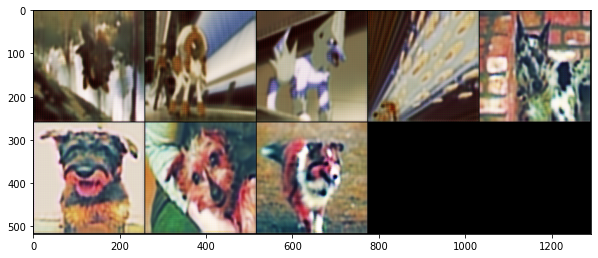

Epoch 0: Step 170: Generator (U-Net) loss: 6.5052690505981445, Discriminator loss: 0.21933989524841307


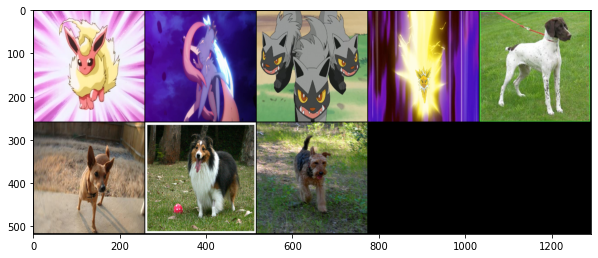

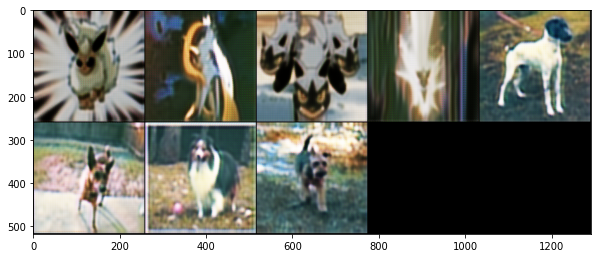

Epoch 0: Step 175: Generator (U-Net) loss: 6.736485195159911, Discriminator loss: 0.2284316599369049


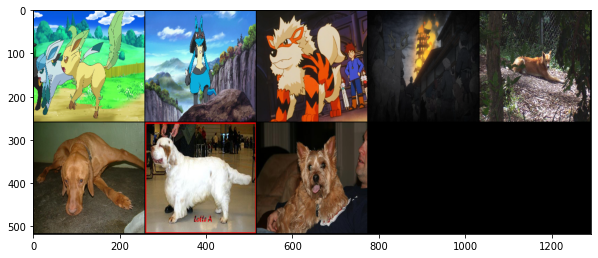

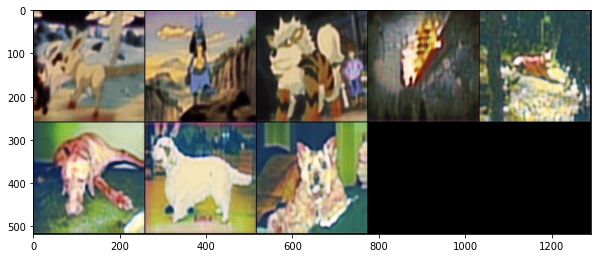

Epoch 0: Step 180: Generator (U-Net) loss: 6.613789272308349, Discriminator loss: 0.21181309521198272


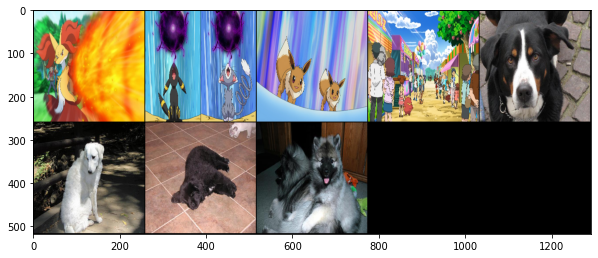

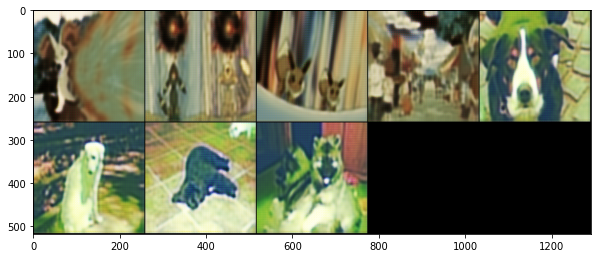

Epoch 0: Step 185: Generator (U-Net) loss: 5.722858619689942, Discriminator loss: 0.23776768445968627


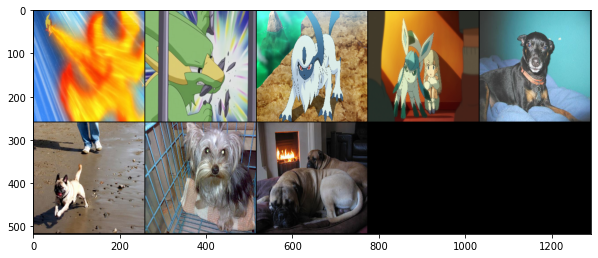

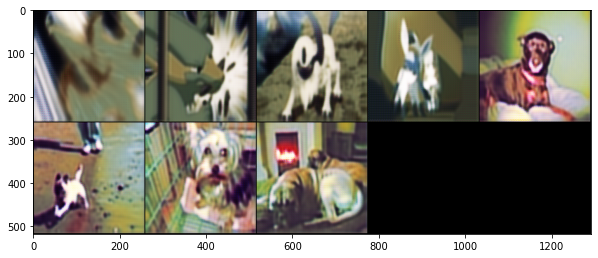

Epoch 0: Step 190: Generator (U-Net) loss: 6.494744300842285, Discriminator loss: 0.23362632393836974


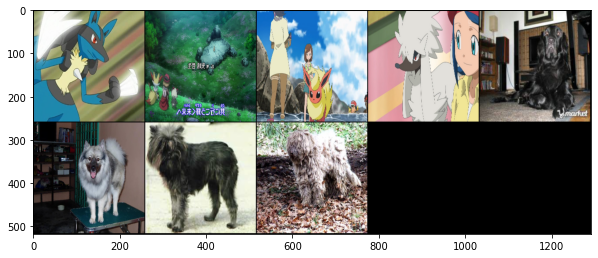

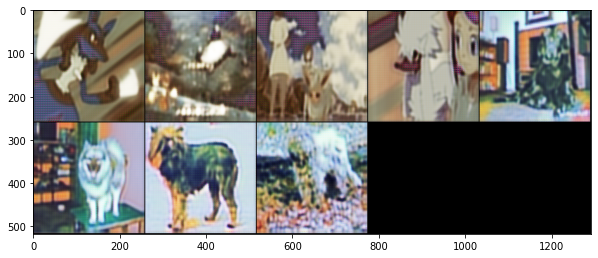

Epoch 0: Step 195: Generator (U-Net) loss: 6.494443893432616, Discriminator loss: 0.2157373160123825


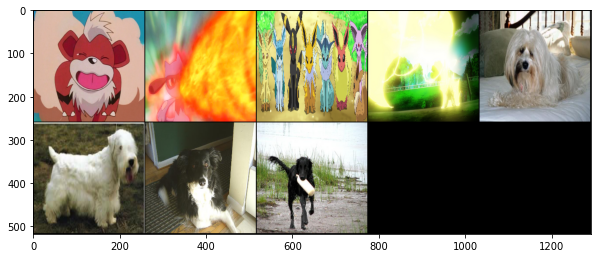

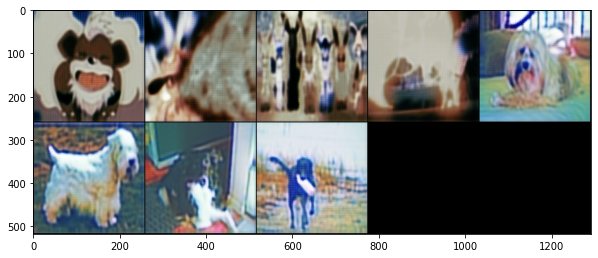

Epoch 0: Step 200: Generator (U-Net) loss: 6.342951107025146, Discriminator loss: 0.2278612494468689


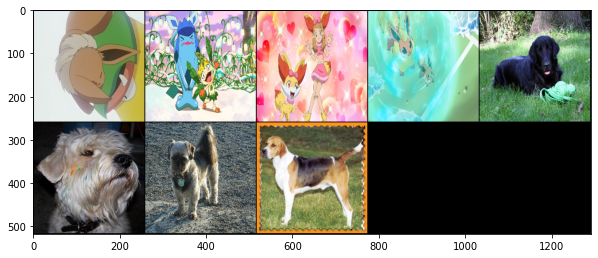

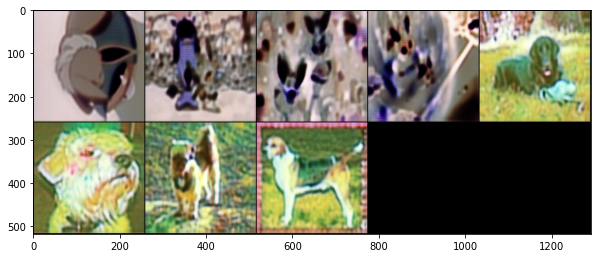

Epoch 0: Step 205: Generator (U-Net) loss: 7.614053630828856, Discriminator loss: 0.26242247223854065


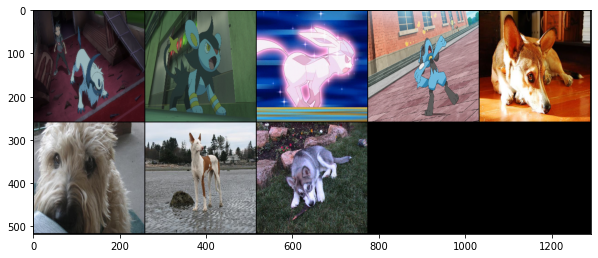

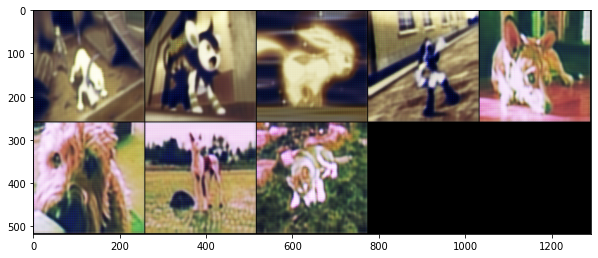

Epoch 0: Step 210: Generator (U-Net) loss: 6.9592608451843265, Discriminator loss: 0.2536636024713516


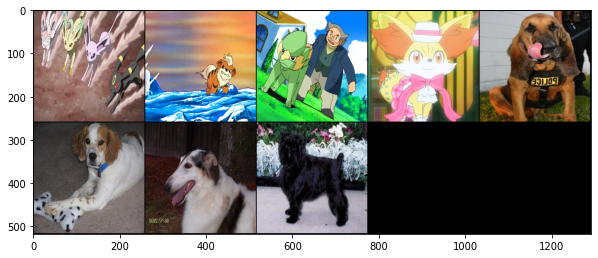

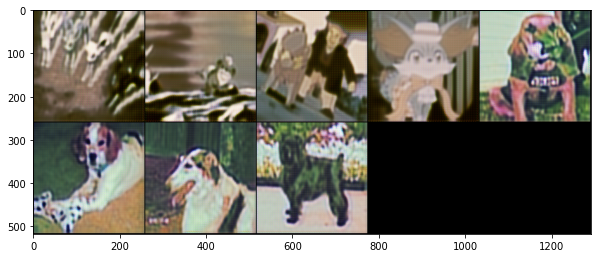

Epoch 0: Step 215: Generator (U-Net) loss: 6.450547695159912, Discriminator loss: 0.22688085436820982


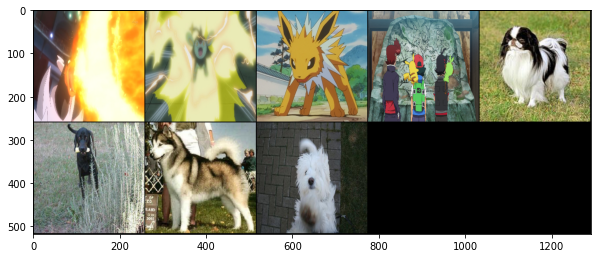

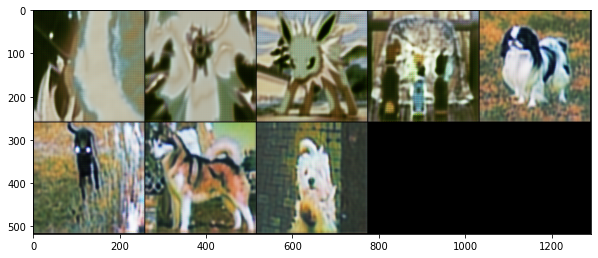

Epoch 0: Step 220: Generator (U-Net) loss: 6.161317253112792, Discriminator loss: 0.21956410408020022


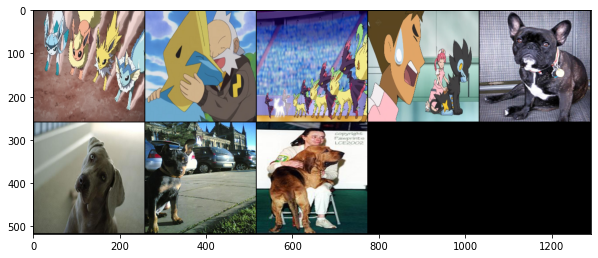

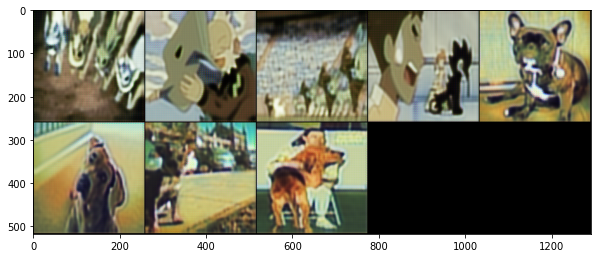

Epoch 0: Step 225: Generator (U-Net) loss: 5.7767352104187015, Discriminator loss: 0.22566969692707065


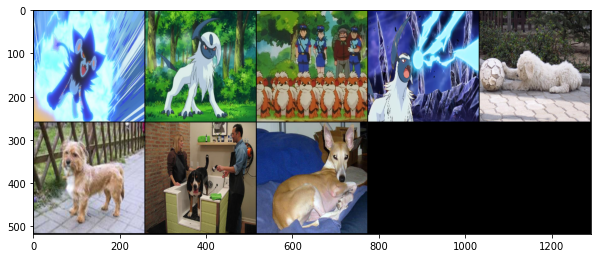

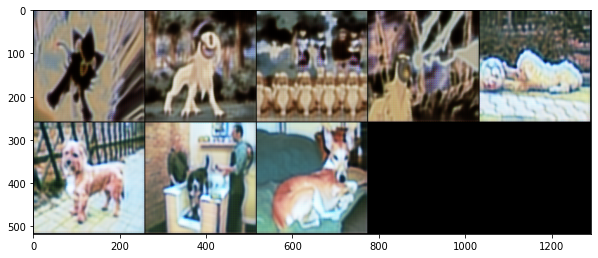

Epoch 0: Step 230: Generator (U-Net) loss: 6.227517986297608, Discriminator loss: 0.22397726476192473


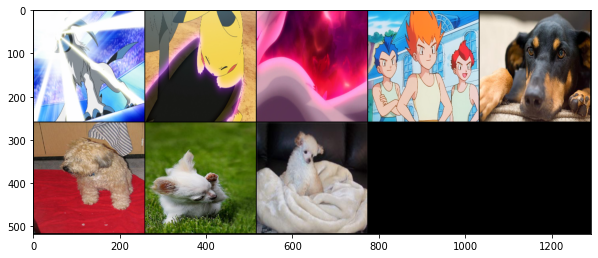

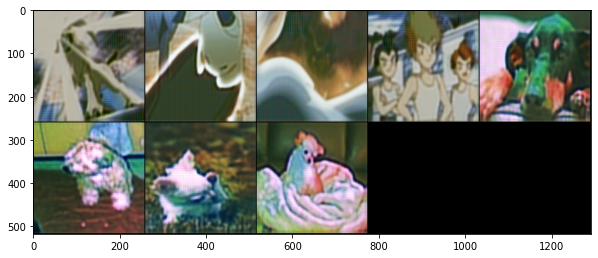

  0%|          | 0/235 [00:00<?, ?it/s]

Epoch 1: Step 235: Generator (U-Net) loss: 6.5002277374267585, Discriminator loss: 0.1984652578830719


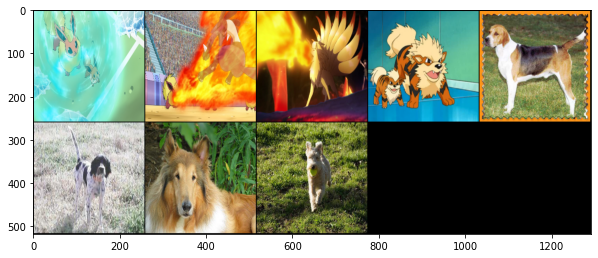

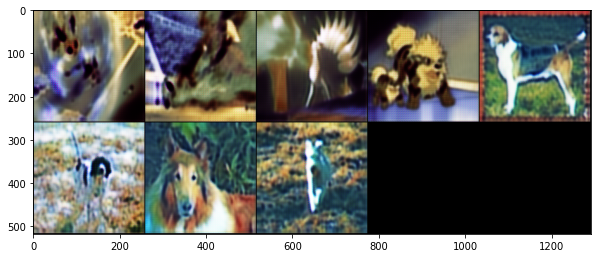

Epoch 1: Step 240: Generator (U-Net) loss: 6.088568592071534, Discriminator loss: 0.21059477031230925


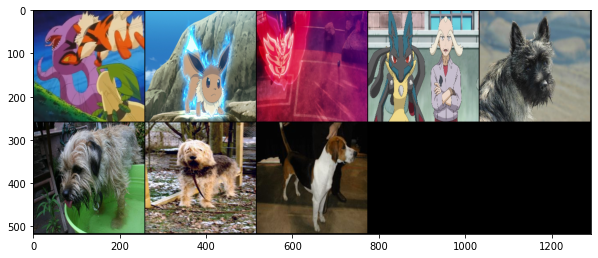

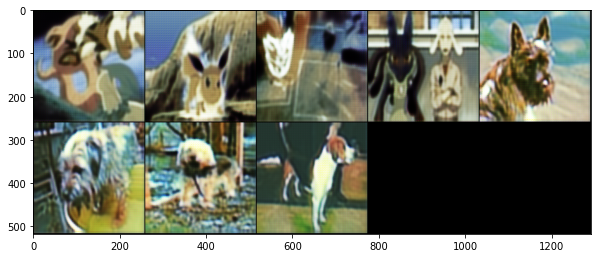

Epoch 1: Step 245: Generator (U-Net) loss: 6.186776256561279, Discriminator loss: 0.2376384049654007


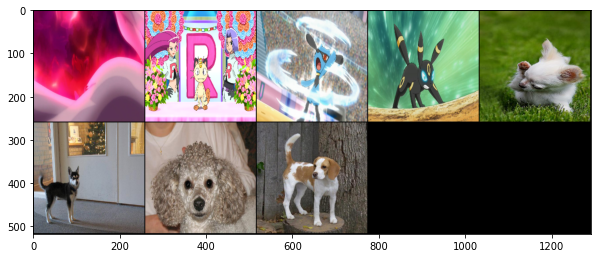

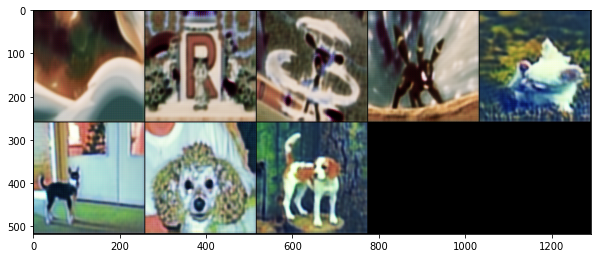

Epoch 1: Step 250: Generator (U-Net) loss: 6.73367748260498, Discriminator loss: 0.20946881771087644


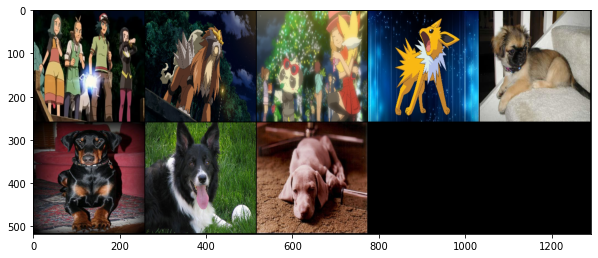

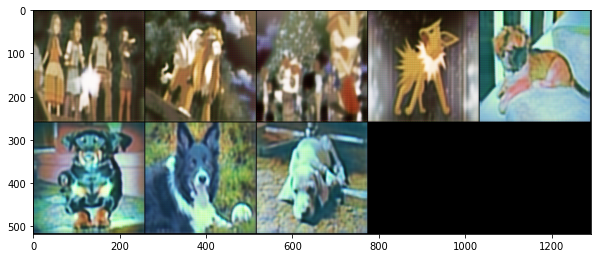

Epoch 1: Step 255: Generator (U-Net) loss: 6.278584003448486, Discriminator loss: 0.21479818522930147


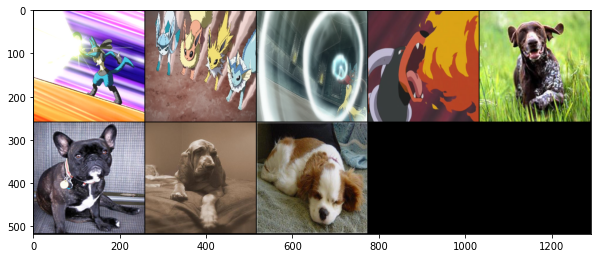

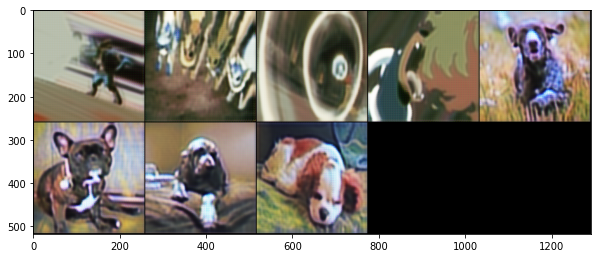

Epoch 1: Step 260: Generator (U-Net) loss: 5.809451866149903, Discriminator loss: 0.27413518428802486


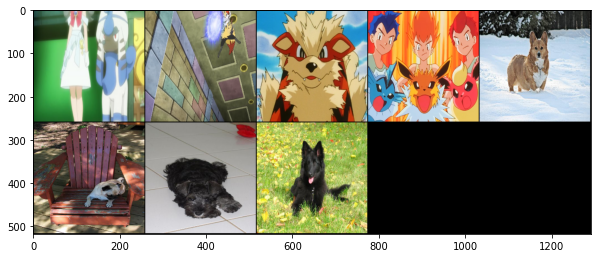

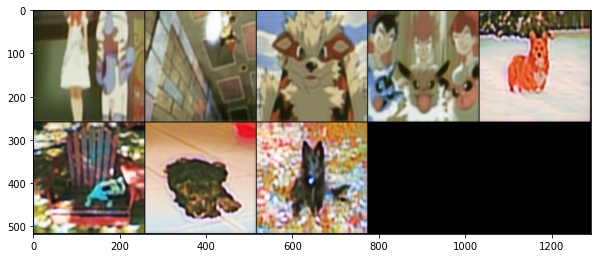

Epoch 1: Step 265: Generator (U-Net) loss: 5.745188617706299, Discriminator loss: 0.24221631586551665


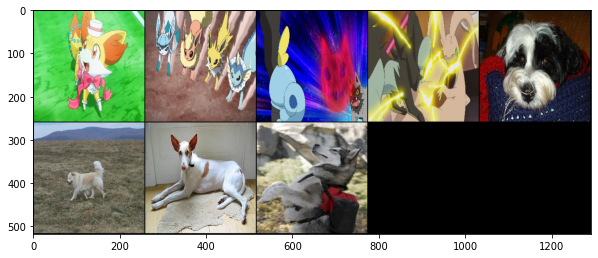

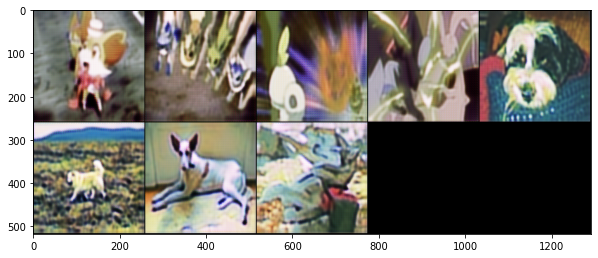

Epoch 1: Step 270: Generator (U-Net) loss: 6.48100175857544, Discriminator loss: 0.23277950286865234


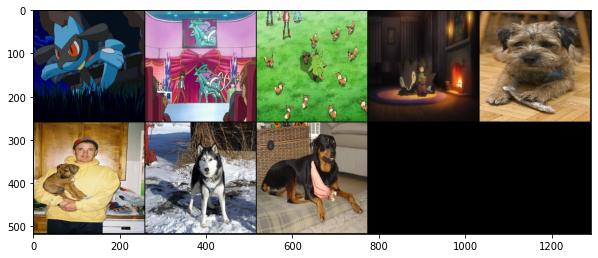

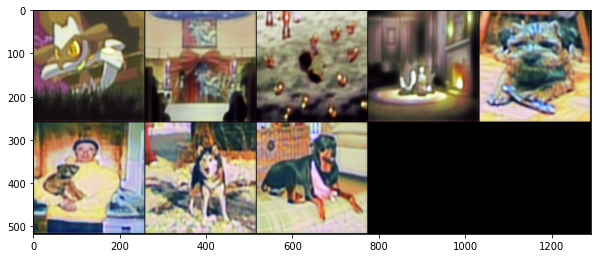

Epoch 1: Step 275: Generator (U-Net) loss: 6.521337604522706, Discriminator loss: 0.22682891190052035


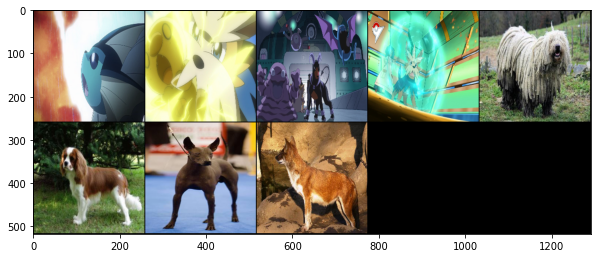

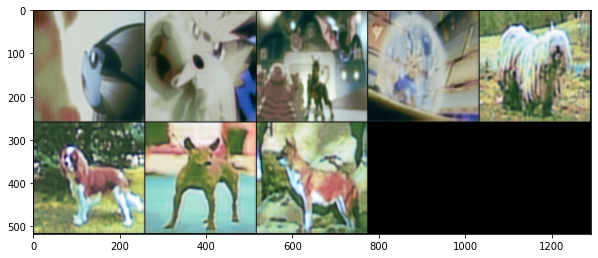

Epoch 1: Step 280: Generator (U-Net) loss: 5.933983421325683, Discriminator loss: 0.2170994222164154


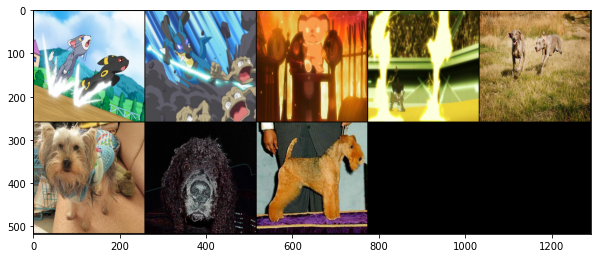

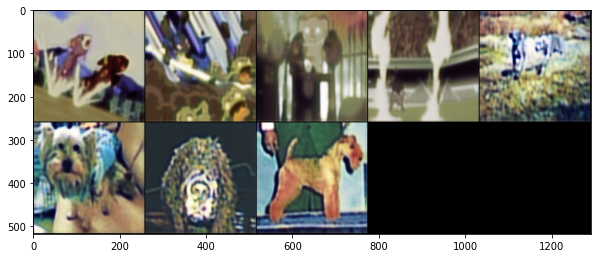

Epoch 1: Step 285: Generator (U-Net) loss: 5.721258354187011, Discriminator loss: 0.2318699836730957


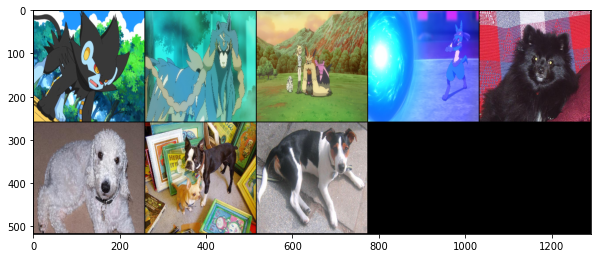

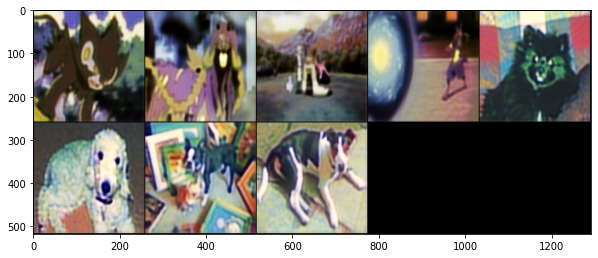

Epoch 1: Step 290: Generator (U-Net) loss: 6.954027080535888, Discriminator loss: 0.2521209746599197


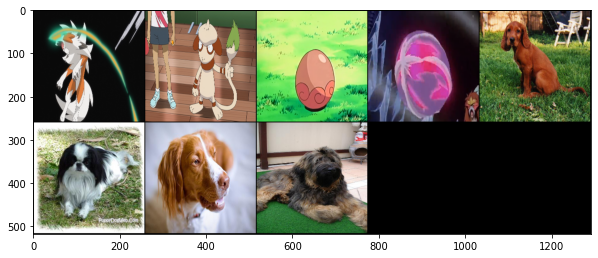

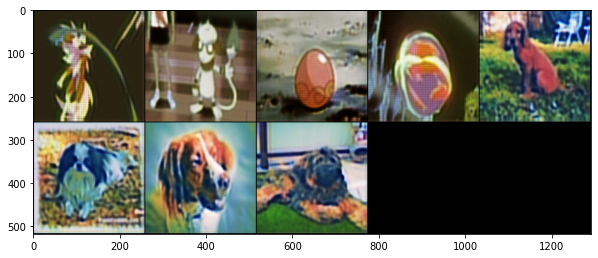

Epoch 1: Step 295: Generator (U-Net) loss: 6.618546485900878, Discriminator loss: 0.21503263711929324


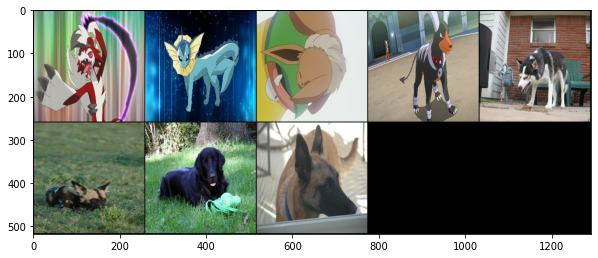

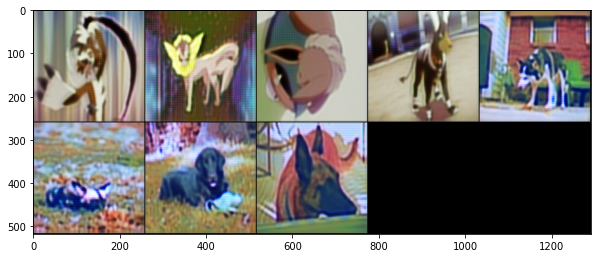

Epoch 1: Step 300: Generator (U-Net) loss: 6.357071685791016, Discriminator loss: 0.20301735401153564


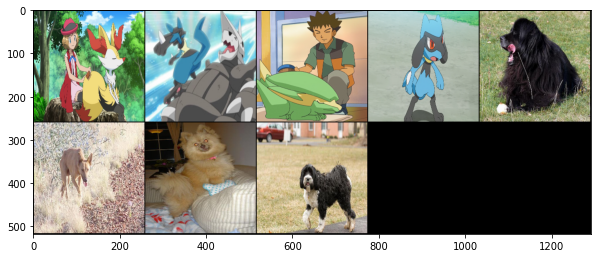

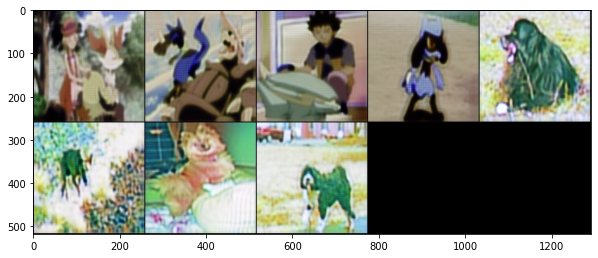

Epoch 1: Step 305: Generator (U-Net) loss: 6.3694174766540534, Discriminator loss: 0.23563656508922576


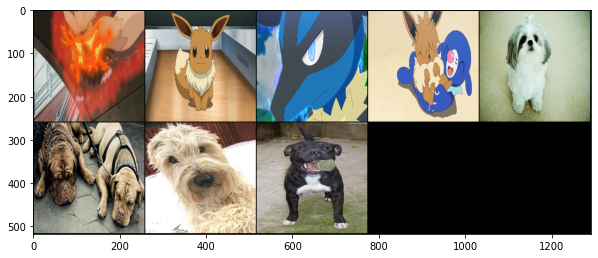

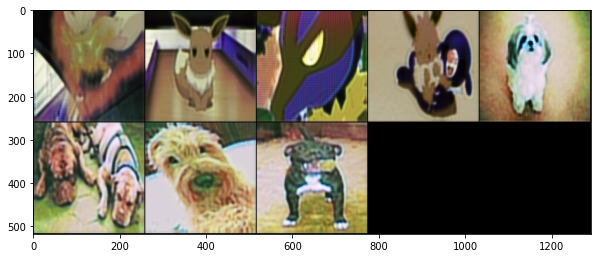

Epoch 1: Step 310: Generator (U-Net) loss: 6.111713123321533, Discriminator loss: 0.25985046923160554


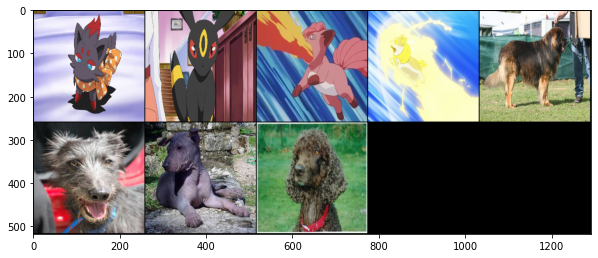

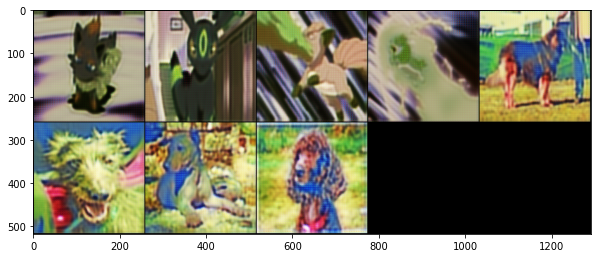

Epoch 1: Step 315: Generator (U-Net) loss: 5.966151237487793, Discriminator loss: 0.2087030678987503


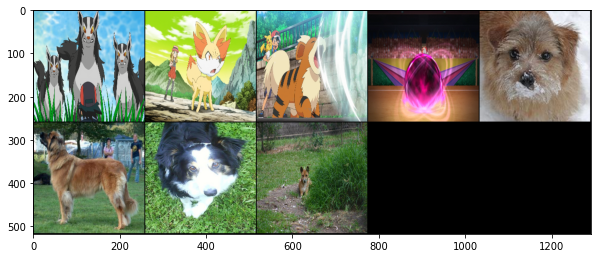

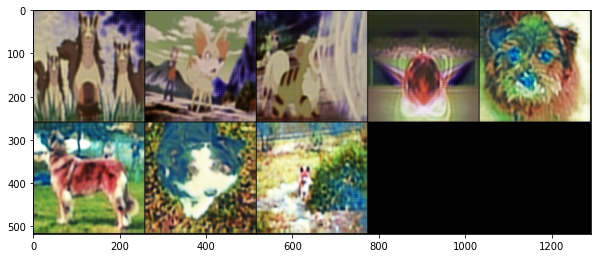

Epoch 1: Step 320: Generator (U-Net) loss: 5.716207122802735, Discriminator loss: 0.21860448718070985


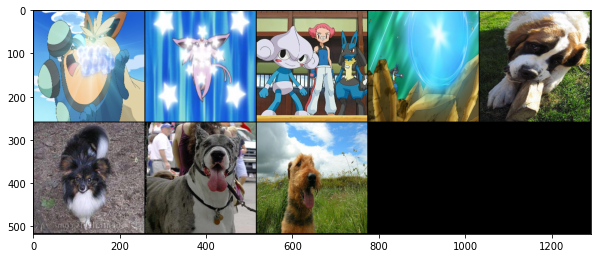

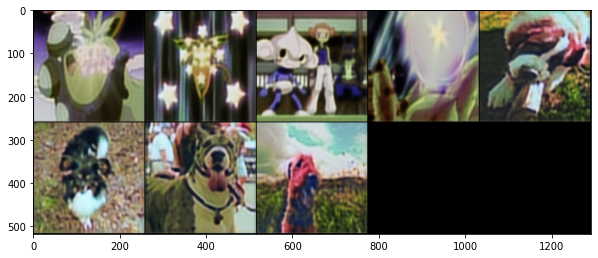

Epoch 1: Step 325: Generator (U-Net) loss: 6.31852159500122, Discriminator loss: 0.22256921529769896


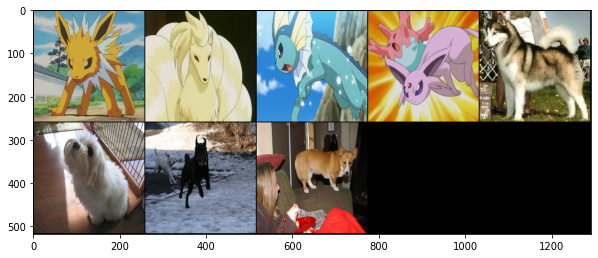

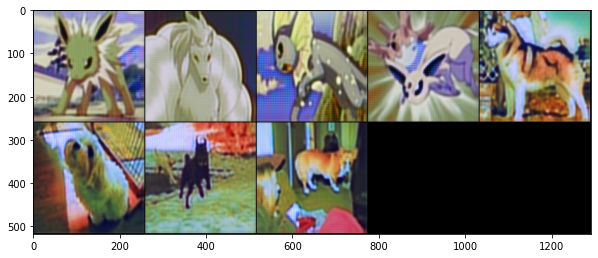

Epoch 1: Step 330: Generator (U-Net) loss: 5.99155101776123, Discriminator loss: 0.22328148186206817


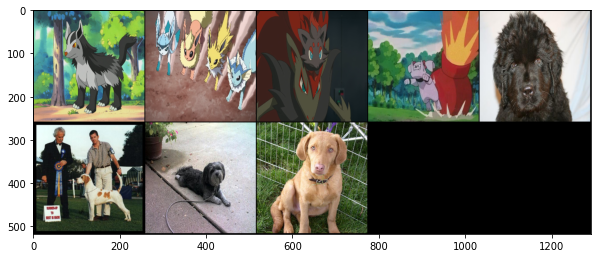

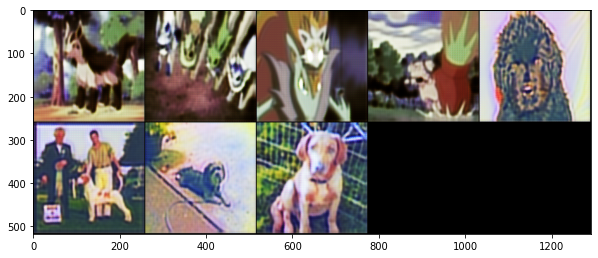

Epoch 1: Step 335: Generator (U-Net) loss: 5.886224842071534, Discriminator loss: 0.2656415343284607


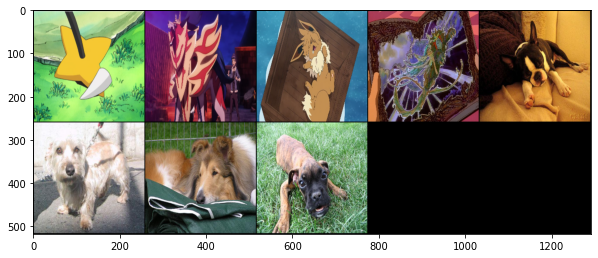

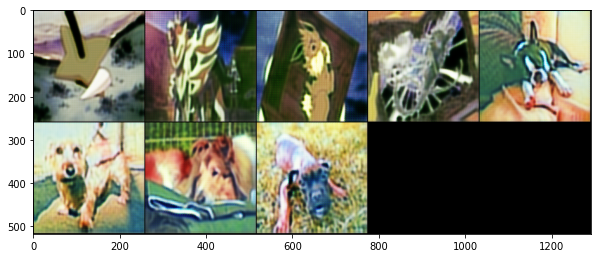

Epoch 1: Step 340: Generator (U-Net) loss: 6.187590026855469, Discriminator loss: 0.21389946043491365


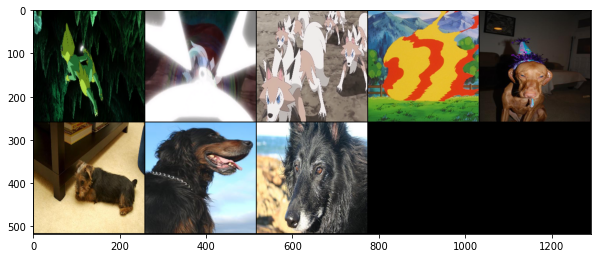

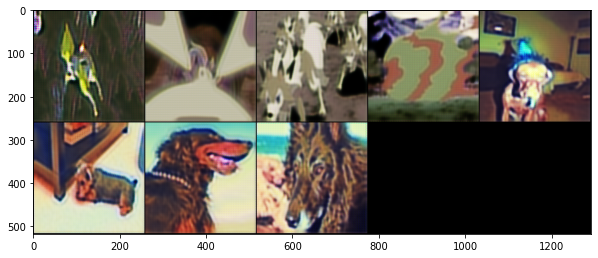

Epoch 1: Step 345: Generator (U-Net) loss: 5.7683178901672365, Discriminator loss: 0.2573835730552673


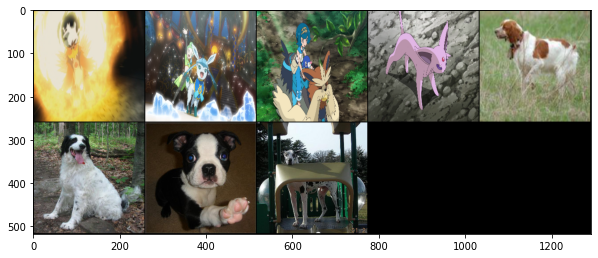

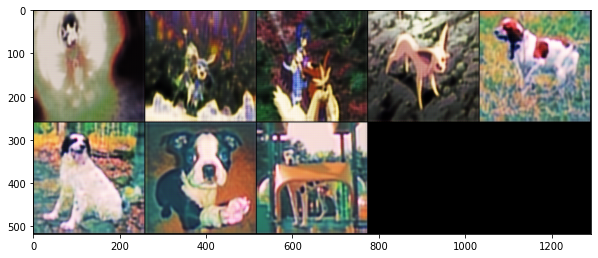

Epoch 1: Step 350: Generator (U-Net) loss: 5.710803031921387, Discriminator loss: 0.23547300398349763


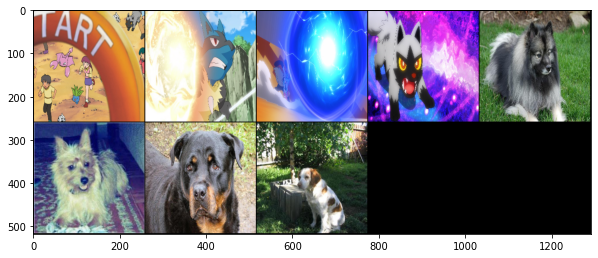

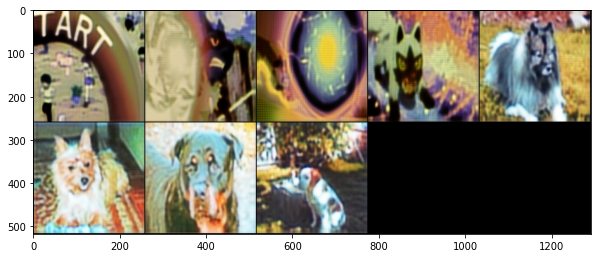

Epoch 1: Step 355: Generator (U-Net) loss: 5.4711884498596195, Discriminator loss: 0.23452453911304477


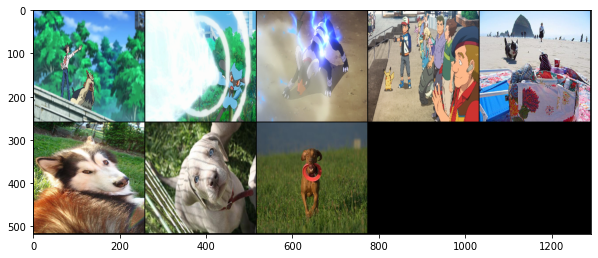

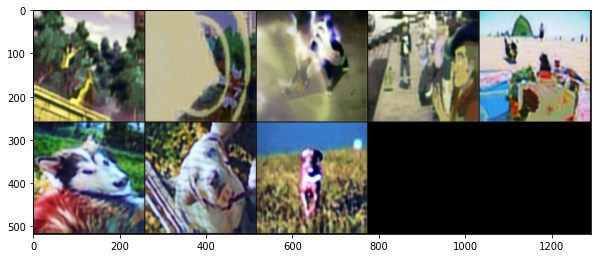

Epoch 1: Step 360: Generator (U-Net) loss: 5.537328720092773, Discriminator loss: 0.20930404961109159


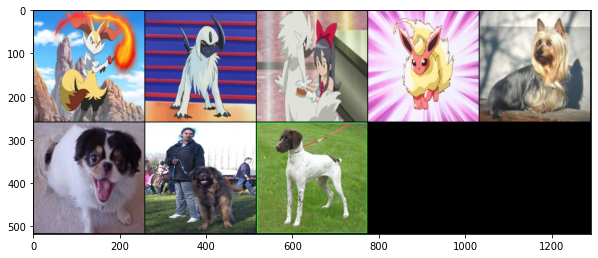

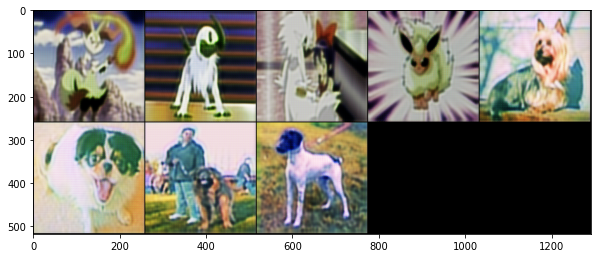

Epoch 1: Step 365: Generator (U-Net) loss: 7.253938102722167, Discriminator loss: 0.21946661472320556


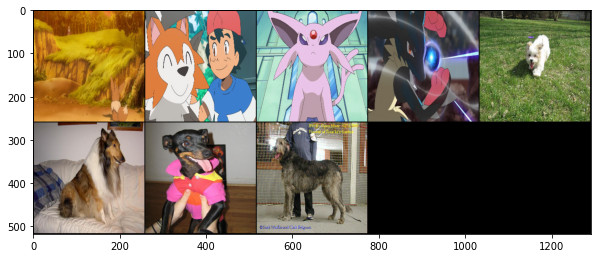

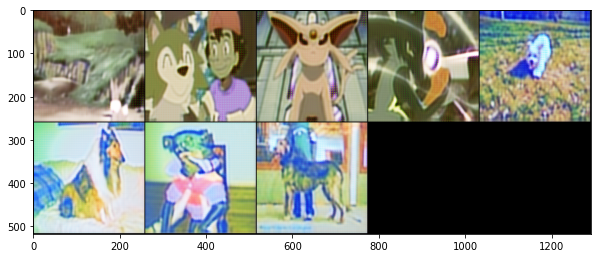

Epoch 1: Step 370: Generator (U-Net) loss: 6.123307132720948, Discriminator loss: 0.23188380599021913


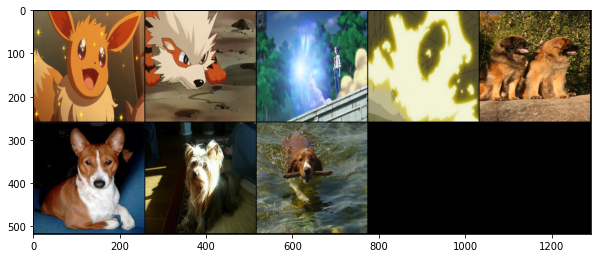

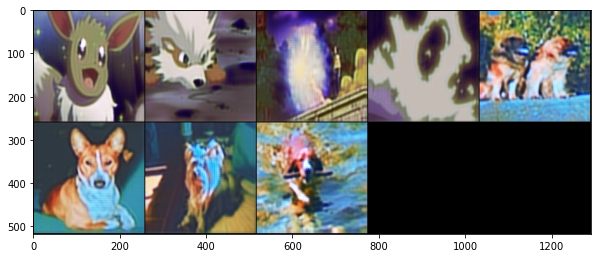

Epoch 1: Step 375: Generator (U-Net) loss: 6.521365547180176, Discriminator loss: 0.2285791158676147


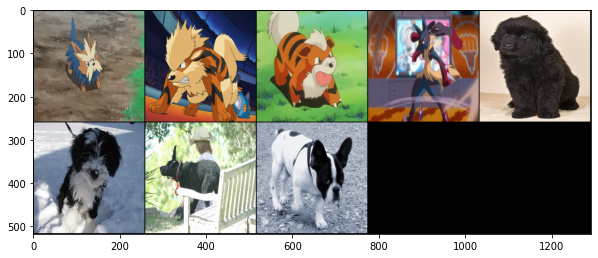

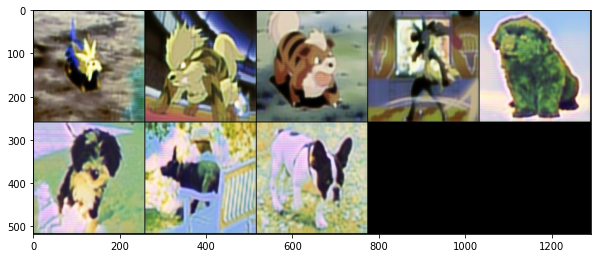

Epoch 1: Step 380: Generator (U-Net) loss: 6.438631057739257, Discriminator loss: 0.253800293803215


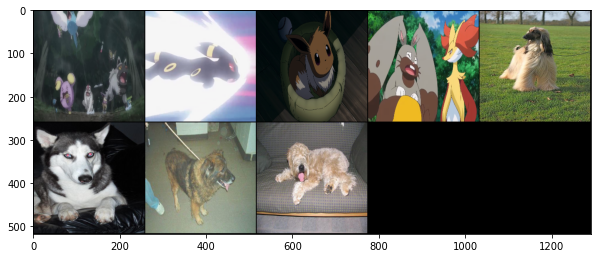

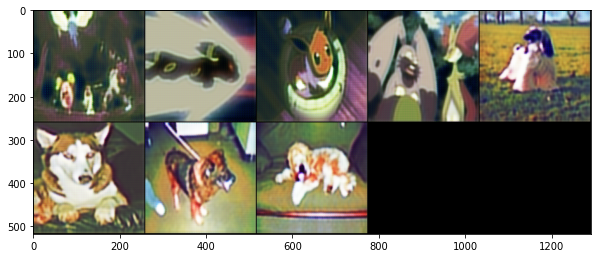

Epoch 1: Step 385: Generator (U-Net) loss: 5.290905380249024, Discriminator loss: 0.24660052359104156


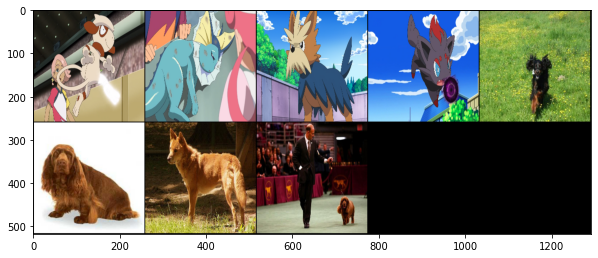

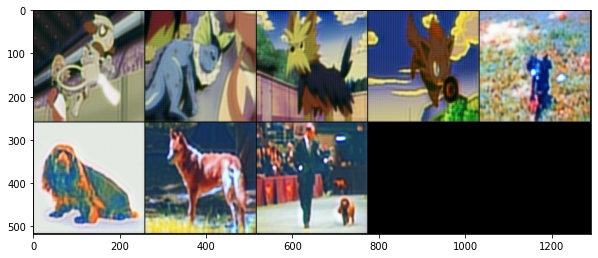

Epoch 1: Step 390: Generator (U-Net) loss: 4.923565673828125, Discriminator loss: 0.24186865985393524


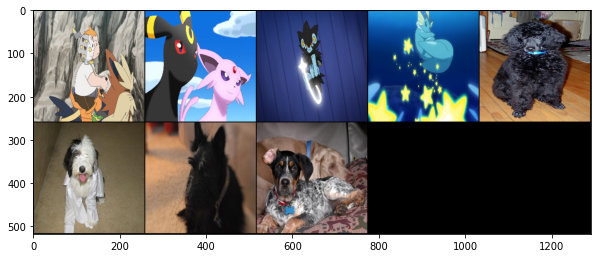

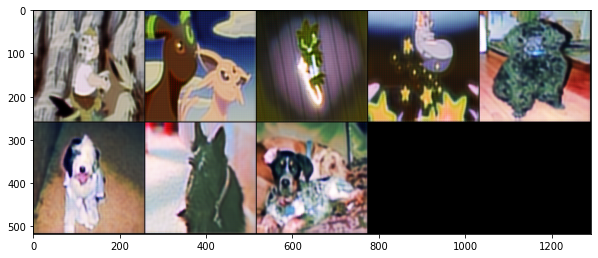

Epoch 1: Step 395: Generator (U-Net) loss: 5.390884017944336, Discriminator loss: 0.23771202564239505


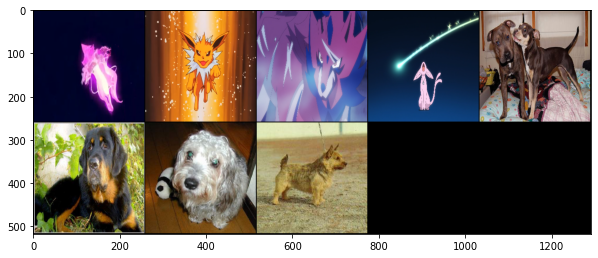

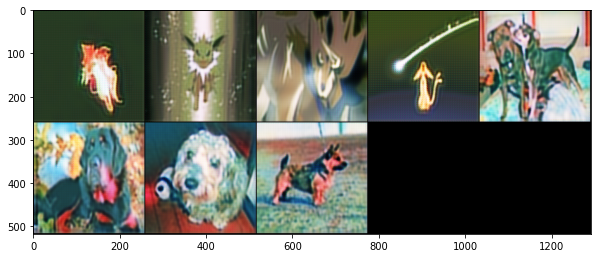

Epoch 1: Step 400: Generator (U-Net) loss: 5.373773860931397, Discriminator loss: 0.2446969270706177


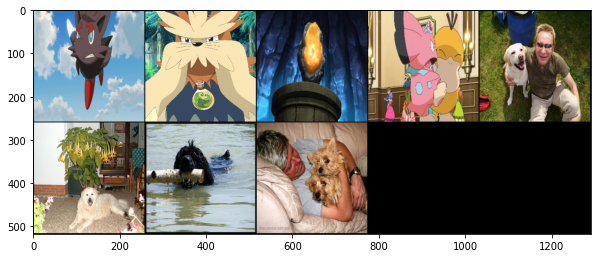

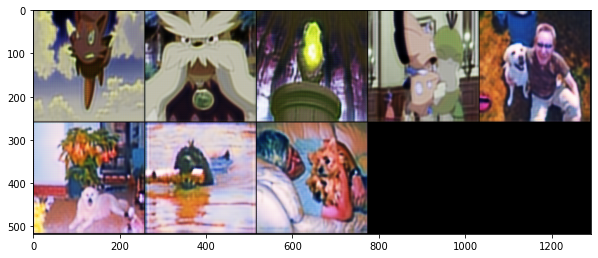

In [ ]:
from skimage import color
import numpy as np
plt.rcParams["figure.figsize"] = (10, 10)


def train(save_model=False):
    mean_generator_loss = 0
    mean_discriminator_loss = 0
    cur_step = 0

    for epoch in range(n_epochs):
        # Dataloader returns the batches
        # for image, _ in tqdm(dataloader):
        for real_A, real_B in tqdm(dataloader):
            # image_width = image.shape[3]
            real_A = nn.functional.interpolate(real_A, size=target_shape)
            real_B = nn.functional.interpolate(real_B, size=target_shape)
            cur_batch_size = len(real_A)
            real_A = real_A.to(device)
            real_B = real_B.to(device)

            ### Update discriminator A ###
            disc_A_opt.zero_grad() # Zero out the gradient before backpropagation
            with torch.no_grad():
                fake_A = gen_BA(real_B)
            disc_A_loss = get_disc_loss(real_A, fake_A, disc_A, adv_criterion)
            disc_A_loss.backward(retain_graph=True) # Update gradients
            disc_A_opt.step() # Update optimizer

            ### Update discriminator B ###
            disc_B_opt.zero_grad() # Zero out the gradient before backpropagation
            with torch.no_grad():
                fake_B = gen_AB(real_A)
            disc_B_loss = get_disc_loss(real_B, fake_B, disc_B, adv_criterion)
            disc_B_loss.backward(retain_graph=True) # Update gradients
            disc_B_opt.step() # Update optimizer

            ### Update generator ###
            gen_opt.zero_grad()
            gen_loss, fake_A, fake_B = get_gen_loss(
                real_A, real_B, gen_AB, gen_BA, disc_A, disc_B, adv_criterion, recon_criterion, recon_criterion
            )
            gen_loss.backward() # Update gradients
            gen_opt.step() # Update optimizer

            # Keep track of the average discriminator loss
            mean_discriminator_loss += disc_A_loss.item() / display_step
            # Keep track of the average generator loss
            mean_generator_loss += gen_loss.item() / display_step

            ### Visualization code ###
            if cur_step % display_step == 0:
                print(f"Epoch {epoch}: Step {cur_step}: Generator (U-Net) loss: {mean_generator_loss}, Discriminator loss: {mean_discriminator_loss}")
                show_tensor_images(torch.cat([real_A, real_B]), size=(dim_A, target_shape, target_shape))
                show_tensor_images(torch.cat([fake_B, fake_A]), size=(dim_B, target_shape, target_shape))
                mean_generator_loss = 0
                mean_discriminator_loss = 0
                # You can change save_model to True if you'd like to save the model
                if save_model:
                    torch.save({
                        'gen_AB': gen_AB.state_dict(),
                        'gen_BA': gen_BA.state_dict(),
                        'gen_opt': gen_opt.state_dict(),
                        'disc_A': disc_A.state_dict(),
                        'disc_A_opt': disc_A_opt.state_dict(),
                        'disc_B': disc_B.state_dict(),
                        'disc_B_opt': disc_B_opt.state_dict()
                    }, f"cycleGAN_{cur_step}.pth")
            cur_step += 1
train()